rpart {rpart}

# rpart: Recursive Partitioning and Regression Trees

　　此函数是rpart包的主干函数，用法丰富，功能强大，本教程以知识点多覆盖、少重复，由简入难的方式展开教学，首先依据官方文档描述函数，然后通过实例介绍：
1. 数据平衡、代价不敏感分类问题：关注生成决策树，cp怎样影响分类性能以及怎样剪枝生成最优决策树，怎样画出、判读决策树，control及parms包含的参数，怎样度量和输出变量的重要性，怎么计算“Surrogate splits”以及“improvement”。
1. 回归问题：相比较分类，回归问题比较简单，关注关注cp怎样剪枝以及怎样生成最优决策树，怎样画出决策树以及control及parms参数的用法，怎样度量和输出变量的重要性。
1. 代价敏感分类问题：这是分类问题的一个重要方面，重点关注怎样设置损失矩阵、怎样依据损失矩阵生成决策树。
1. Poisson回归：将Poisson分布值作为回归的目标。
1. 生存分析：一类特殊的Possion回归。
1. 缺失值问题：生成和应用决策树时自变量值缺失如何应对。

为避免翻译不准确，有的地方直接使用或配以官方英文介绍。

　　总体上，请关注rpart决策树的以下性能：
1. 决策机理清晰--可清晰看到其推理过程。
2. 分类和回归的自变量即允许连续变量，也允许离散变量。
3. 无需自变量之间相互独立。
4. 方便评价自变量的重要性。
5. 方便实现代价敏感分类。
6. 有效地应对自变量缺失。

理论参见：

- https://zhuanlan.zhihu.com/p/85731206

### Description

Fit a `rpart` model

### Usage

```r
rpart(formula, data, weights, subset, na.action = na.rpart, method,
      model = FALSE, x = FALSE, y = TRUE, parms, control, cost, ...)
      
```

### Arguments

|             |                                                              |
| ----------- | ------------------------------------------------------------ |
| `formula`   | a [formula](http://127.0.0.1:42851/help/library/rpart/help/formula), with a response but no interaction terms. If this is a data frame, it is taken as the model frame (see `model.frame).` |
| `data`      | an optional data frame in which to interpret the variables named in the formula. |
| `weights`   | optional case weights.                                       |
| `subset`    | optional expression saying that only a subset of the rows of the data should be used in the fit. |
| `na.action` | the default action deletes all observations for which `y` is missing, but keeps those in which one or more predictors are missing. 默认的办法是删除因变量缺失的观测而保留自变量缺失的观测。 |
| `method`    | one of `"anova"`, `"poisson"`, `"class"` or `"exp"`. If `method` is missing then the routine tries to make an intelligent guess. If `y` is a survival object, then `method = "exp"` is assumed, if `y` has 2 columns then `method = "poisson"` is assumed, if `y` is a factor then `method = "class"` is assumed, otherwise `method = "anova"` is assumed. It is wisest to specify the method directly, especially as more criteria may added to the function in future.Alternatively, `method` can be a list of functions named `init`, `split` and `eval`. Examples are given in the file ‘tests/usersplits.R’ in the sources, and in the vignettes ‘User Written Split Functions’. |
| `model`     | if logical: keep a copy of the model frame in the result? If the input value for `model` is a model frame (likely from an earlier call to the `rpart` function), then this frame is used rather than constructing new data. |
| `x`         | keep a copy of the `x` matrix in the result.                 |
| `y`         | keep a copy of the dependent variable in the result. If missing and `model` is supplied this defaults to `FALSE`. |
| `parms`     | optional parameters for the splitting function. Anova splitting has no parameters. Poisson splitting has a single parameter, the coefficient of variation of the prior distribution on the rates. The default value is 1. Exponential splitting has the same parameter as Poisson. For classification splitting, the list can contain any of: the vector of prior probabilities (component `prior`), the loss matrix (component `loss`) or the splitting index (component `split`). The priors must be positive and sum to 1. The loss matrix must have zeros on the diagonal and positive off-diagonal elements. The splitting index can be `gini` or `information`. The default priors are proportional to the data counts, the losses default to 1, and the split defaults to `gini`. |
| `control`   | a list of options that control details of the `rpart` algorithm. See `rpart.control`. |
| `cost`      | a vector of non-negative costs, one for each variable in the model. Defaults to one for all variables. These are scalings to be applied when considering splits, so the improvement on splitting on a variable is divided by its cost in deciding which split to choose. |
| `...`       | arguments to `rpart.control` may also be specified in the call to `rpart`. They are checked against the list of valid arguments. |

### Details

This differs from the `tree` function in S mainly in its handling of surrogate variables. In most details it follows Breiman *et. al* (1984) quite closely. **R** package **tree** provides a re-implementation of `tree`.

### Value

An object of class `rpart`. See `rpart.object`.

### References

Breiman L., Friedman J. H., Olshen R. A., and Stone, C. J. (1984) *Classification and Regression Trees.* Wadsworth.

Therneau, T.M. and E.J. Atkinson. An Introduction to Recursive Partitioning Using the RPART Routines. 2015.

### See Also

```
rpart.control`, `rpart.object`, `summary.rpart`, `print.rpart
```

## 示例

以abalone数据集为主干，根据需要改造成回归问题、分类问题(平衡和非平衡)。

参数method有四种取值：程序会根据因变量的类型自动选择方法：
- 连续型⇒“anova”，做回归
- 离散型⇒“class”，做分类
- 计数型（泊松过程）⇒“poisson”
- 生存分析型⇒“exp”。

但最好还是指明参数，以便用错。

### 例1  分类：平衡、代价不敏感、无缺失值、特征混合取值
根据一系列特征，判断abalone年龄的高低(将原始数据改造成H/L二个类别)，Rings为目标属性--**类别值**，特征混合取值--**既有离散取值，也有连续取值**。　

数据集平衡即数据集中目标变量各个类别的占比基本相同--分类器不容易“偷懒”地将所有样例认定为大类从而获得低的错判率。　　

   
理论参见：
   
- https://zhuanlan.zhihu.com/p/139523931

In [1]:
library(pacman)

options(warn = -1) # 忽略一切警告
options("width" = 140) # 充分利用打印宽度
options(repr.plot.width = 15, repr.plot.height = 10) # 满幅

p_load(rpart)
p_load(rattle)    #使用其中的fancyRpartPlot函数
p_load(skimr)
s <- skim_tee
p_load(AppliedPredictiveModeling)

In [2]:
data(abalone)
ab <- abalone
ab$Rings <- factor((ab$Rings) > 9, labels = c("L", "H")) # 处理成二类，逻辑型factor的levels的排序默认是：FALSE,TRUE，分别对应于"L","H"
s(ab)

── Data Summary ────────────────────────
                           Values
Name                       data  
Number of rows             4177  
Number of columns          9     
_______________________          
Column type frequency:           
  factor                   2     
  numeric                  7     
________________________         
Group variables            None  

── Variable type: factor ───────────────────────────────────────────────────────────────────────────────────────────────────────────────────
  skim_variable n_missing complete_rate ordered n_unique top_counts               
1 Type                  0             1 FALSE          3 M: 1528, I: 1342, F: 1307
2 Rings                 0             1 FALSE          2 L: 2096, H: 2081         

── Variable type: numeric ──────────────────────────────────────────────────────────────────────────────────────────────────────────────────
  skim_variable n_missing complete_rate  mean     sd     p0    p25   p50   p75  p100 h

In [3]:
# 将数据集1:1随机分割成训练集和测试集
set.seed(100)
I <- sample(nrow(ab), nrow(ab) * 0.5)
train_ab <- ab[I, ]
test_ab <- ab[-I, ]
s(train_ab)

── Data Summary ────────────────────────
                           Values
Name                       data  
Number of rows             2088  
Number of columns          9     
_______________________          
Column type frequency:           
  factor                   2     
  numeric                  7     
________________________         
Group variables            None  

── Variable type: factor ───────────────────────────────────────────────────────────────────────────────────────────────────────────────────
  skim_variable n_missing complete_rate ordered n_unique top_counts            
1 Type                  0             1 FALSE          3 M: 776, I: 675, F: 637
2 Rings                 0             1 FALSE          2 L: 1044, H: 1044      

── Variable type: numeric ──────────────────────────────────────────────────────────────────────────────────────────────────────────────────
  skim_variable n_missing complete_rate  mean     sd     p0    p25   p50   p75  p100 hist 
1 Lo

In [4]:
set.seed(2)    #固定xstd：xerror具有随机性--数据随机分割的原因
ctab <- rpart(Rings ~ .,data = train_ab, method = "class", cp = 0)   #cp=0--取消cp在模型复杂度上的约束
summary(ctab)
#从各个splits(分枝)可见，其improve值逐层下降--优先选择improve大的变量作为当前的分枝变量。

Call:
rpart(formula = Rings ~ ., data = train_ab, method = "class", 
    cp = 0)
  n= 2088 

             CP nsplit rel error    xerror       xstd
1  0.5134099617      0 1.0000000 1.0670498 0.02183516
2  0.0167624521      1 0.4865900 0.5047893 0.01901258
3  0.0148467433      3 0.4530651 0.4741379 0.01861422
4  0.0076628352      5 0.4233716 0.4501916 0.01827984
5  0.0067049808      6 0.4157088 0.4492337 0.01826603
6  0.0057471264      9 0.3955939 0.4511494 0.01829362
7  0.0047892720     10 0.3898467 0.4444444 0.01819643
8  0.0043103448     17 0.3563218 0.4386973 0.01811177
9  0.0038314176     19 0.3477011 0.4444444 0.01819643
10 0.0019157088     20 0.3438697 0.4549808 0.01834840
11 0.0016762452     28 0.3266284 0.4827586 0.01872954
12 0.0015964240     36 0.3045977 0.4837165 0.01874219
13 0.0014367816     39 0.2998084 0.4875479 0.01879248
14 0.0009578544     43 0.2940613 0.4885057 0.01880498
15 0.0004789272     49 0.2883142 0.4923372 0.01885464
16 0.0000000000     58 0.2835249 0.5000000 

**观察以上输出**

--cp表：

- rel error是训练集误差，error为错判率 = 判错总个数 / 样例总个数。
    - 随着cp的下降，nsplit全程上升(决策树越来越庞大)，rel error全程而下降，表明cp越低决策树越复杂，训练集误差越低。
- xerror是多折交叉验证得到的误差值均值。
    - xerror首先随着随着cp的下降而下降，然后开始上升，表明cp越低决策树越复杂，会引起过拟合，降低泛化性能。
    - xerror都大于同行的rel error，可见rel error偏乐观。
- rel error和xerror都是以Root node error为基准的相对值--为了便于比较。
- xstd是xerror的标准差，反映xerror的变动情况，xerror具有随机性--数据随机分割的缘故。
    - 1-SE原则：最优cp值为最小xerror的cp点的1-SE范围内的最大值，参见https://stats.stackexchange.com/questions/92547/r-rpart-cross-validation-and-1-se-rule-why-is-the-column-in-cptable-called-xst 

--Variable importance排序 

Avariable may appear in the tree many times, either as a primary or a surrogate variable. An overall measure of variable importance is the sum of the goodness of split measures for each split for which it was the primary variable, plus goodness * (adjusted agreement) for all splits in which it was a surrogate. In the printout these are scaled to sum to 100 and the rounded values are shown, omitting any variable whose proportion is less than 1%.变量可以作为主变量或代理变量多次出现在树中。变量重要性的总体度量是将其作为主要变量的每个分割的分割度量的优度(improve)之和，加上将其作为替代变量的所有分割的优度(improve)*(adjusted agreement)。在打印输出中，这些值被缩放到总和为100，并显示四舍五入的值，省略任何比例小于1%的变量。

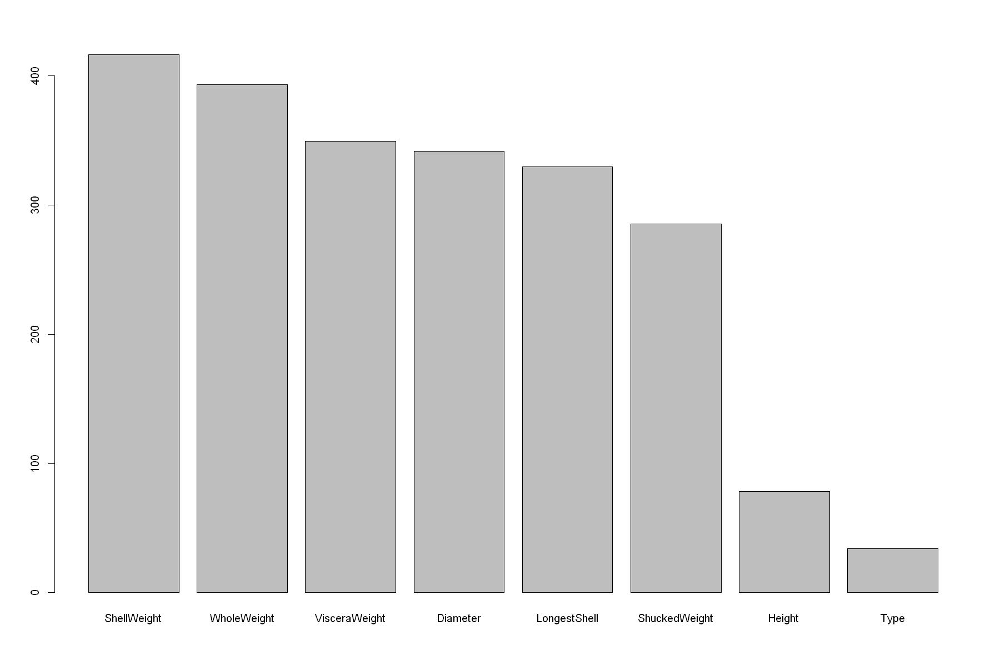

In [5]:
barplot(ctab$variable.importance)

--“improve”怎么计算？

The improvement is n times the change in impurity index 

improvement = 分枝前(节点样例个数 × “impurity index”) - 分支后(节点样例个数 × “impurity index”)之和

比如根节点的分枝：

In [6]:
addmargins(with(train_ab, table(cut(ShellWeight, c(0, 0.2545, Inf)),Rings,exclude = NULL)))

,L,H,Sum
"(0,0.254]",851,315,1166
"(0.254,Inf]",193,729,922
Sum,1044,1044,2088


improvement = 1044 - 1166[ 1-(851/1166)<sup>2</sup> - (315/1166)<sup>2</sup> ] - 922[ 1 - (193/922)<sup>2</sup>-(729/922)<sup>2</sup> ] = 278.9977

--“Surrogate splits”怎么得到？

 　　按照“agree”降序排列，“agree”是该替代分枝与原分枝的一致程度，以根节点的分枝为例：

In [7]:
with(train_ab, table(cut(ShellWeight, c(0, 0.2545, Inf)),cut(WholeWeight, c(0, 0.89975, Inf)),exclude = NULL))

             
              (0,0.9] (0.9,Inf]
  (0,0.254]      1100        66
  (0.254,Inf]      93       829

注意：原分枝是“ShellWeight < 0.2545  to the left”，替代分枝是“WholeWeight < 0.89975 to the left”，所以其agree为：

In [8]:
(1100 + 829) / (1100 + 829 + 93 + 66)

[1] 0.9238506

“adj”(adjusted agreement)计算：

　　若该数据集所有的样例的ShellWeight值缺失，不依赖其他属性，将其认定为“< 0.2545”,正确的个数为1100+66，替代分枝“WholeWeight < 0.89975 ”的作用体现在剩下的(1100 + 829 + 93 + 66 - (1100 + 66))样例中正确认定了(1100 + 829 - (1100 + 66))个，所以adj为：

In [9]:
(1100 + 829 - (1100 + 66)) / (1100 + 829 + 93 + 66 - (1100 + 66))

[1] 0.8275488

**cp逐降，xerror的变化情况：**

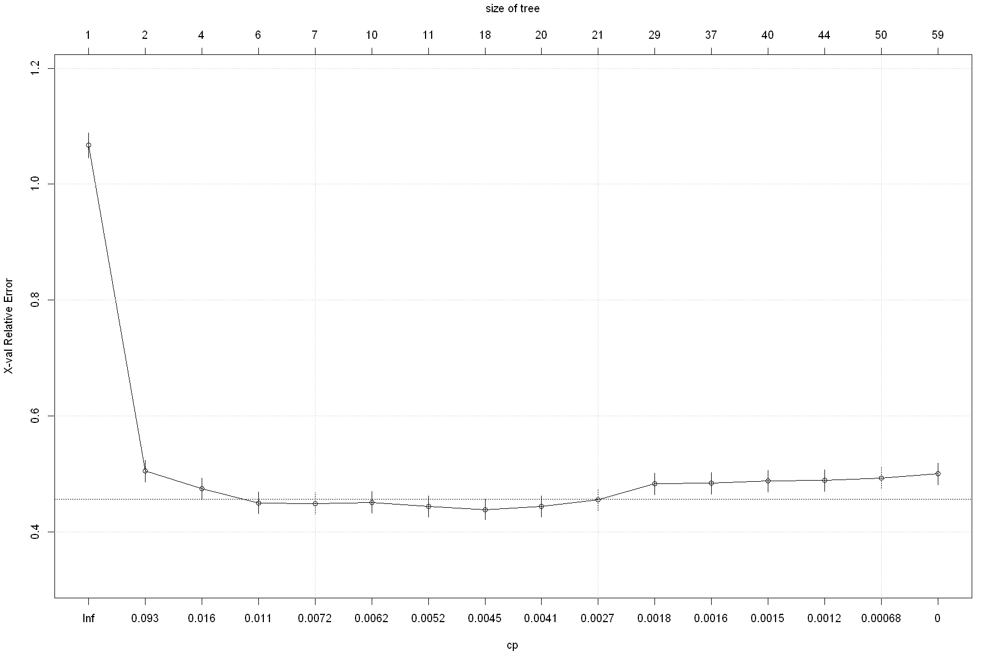

In [10]:
plotcp(ctab)    #图示，横坐标值是上表二个连续cp值的几何平均值--取值可以介于二者之间之意
grid()
#可见cp在0.0045附近，xerror最小，根据1-SE原则，0.011附近cp最优

**画出决策树**

png 
  2

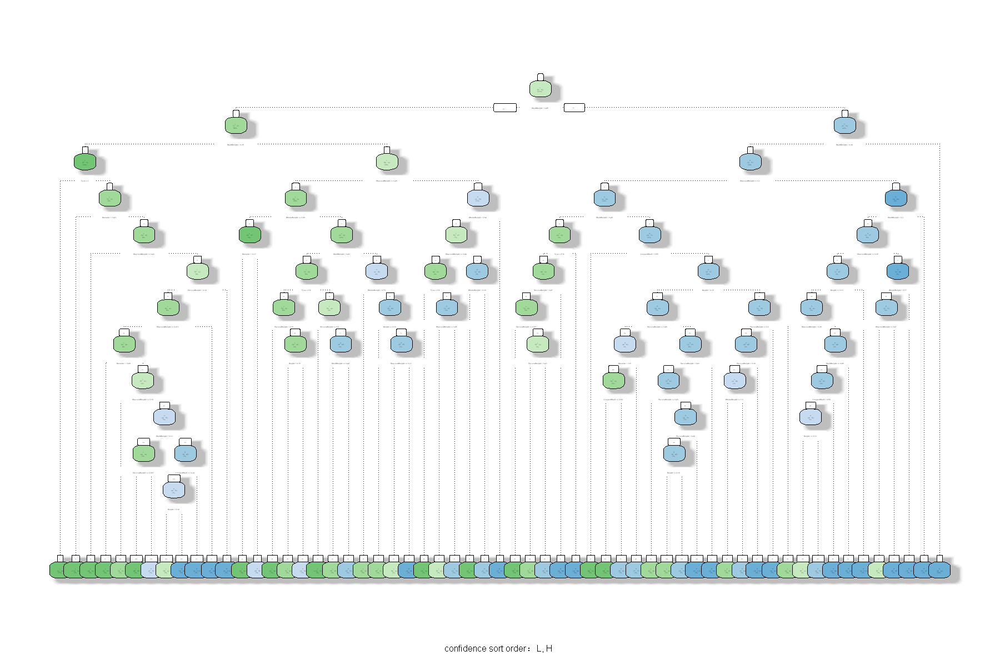

In [11]:
fancyRpartPlot(ctab, caption = paste("confidence sort order：",toString(levels(train_ab$Rings))))  # 画出cp=0决策树--其他控制分枝的参数为默认值

pdf("ctab.pdf", width = 5, height = 5) # 输出为pdf格式，可清晰放大
fancyRpartPlot(ctab, caption = paste("confidence sort order：",toString(levels(train_ab$Rings))))   #第二行是按照字典顺序输出该节点中各类别的占比
dev.off()

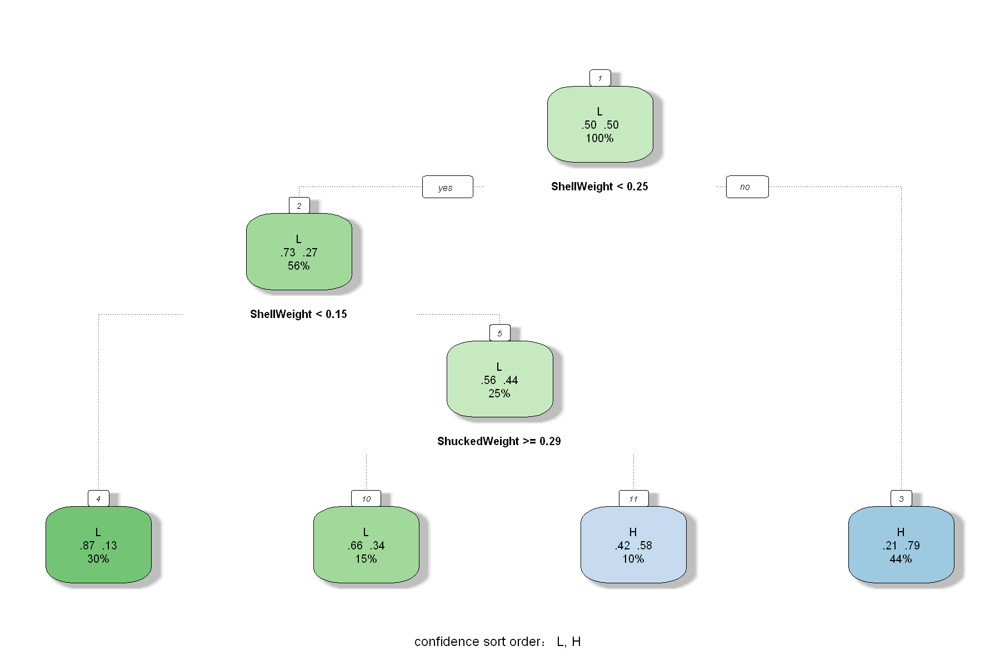

In [12]:
ctab1 <- rpart(Rings ~ .,data = train_ab, cp = 0.015)   #cp值在第2行和第3行之间
fancyRpartPlot(ctab1, caption = paste("confidence sort order：",toString(levels(train_ab$Rings)))) 
#可见叶节点数是第3行nsplit+1

最优决策树

png 
  2

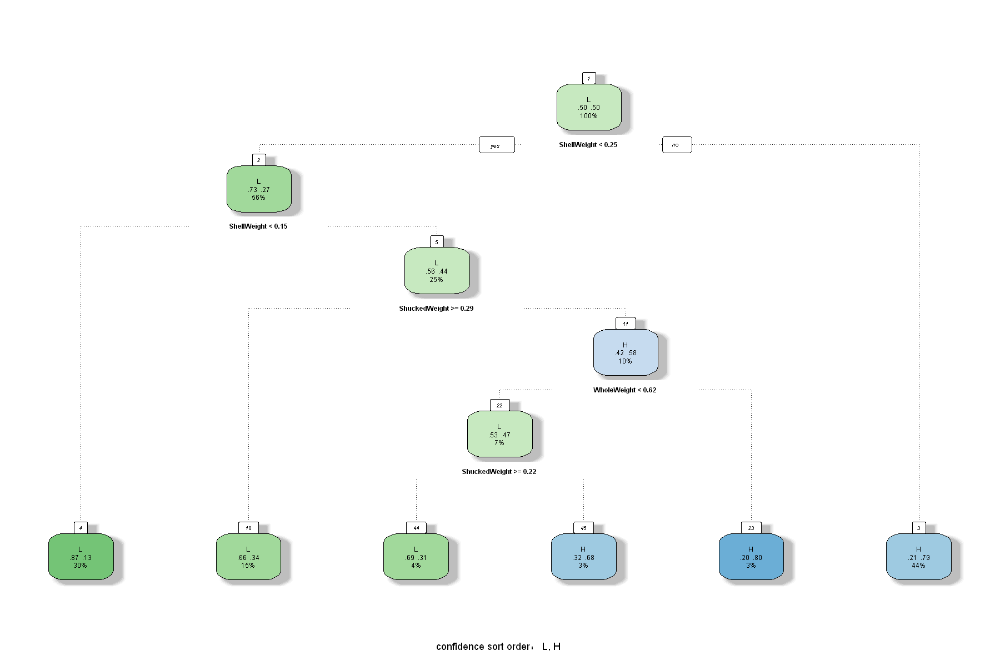

In [13]:
# 由xerror 1-SE原则认定最优cp=0.011

crtabo <- rpart(Rings ~ ., data = train_ab, method = "class", cp = 0.011)
fancyRpartPlot(crtabo, caption = paste("confidence sort order：", toString(levels(train_ab$Rings))))

pdf("crtabo.pdf", width = 4, height = 4) # 输出为pdf格式，可清晰放大
fancyRpartPlot(crtabo, caption = paste("confidence sort order：", toString(levels(train_ab$Rings))))
dev.off()

错误率－最优决策树

In [14]:
pred_tr <- predict(crtabo, train_ab, type = "class")      #训练集的预测值
(error_train <- mean(pred_tr != train_ab$Rings))  #训练集的错误率
pred_te <- predict(crtabo, test_ab, type = "class")       #测试集的预测值
(error_test <- mean(pred_te != test_ab$Rings))    #测试集的错误率

[1] 0.2116858

[1] 0.2192437

**cp对分类性能的影响：**

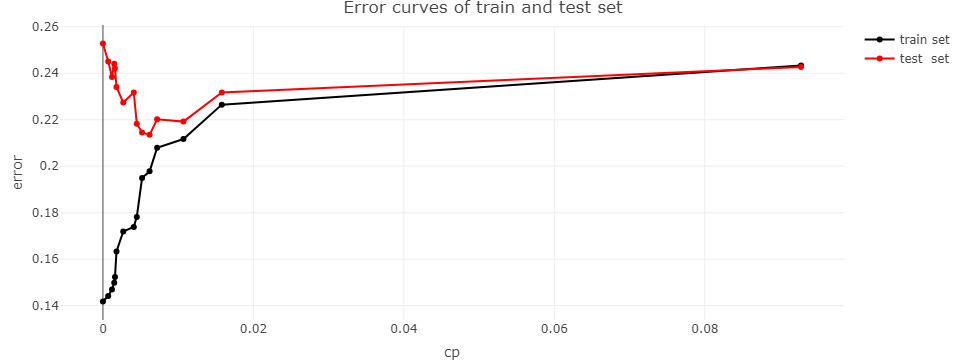

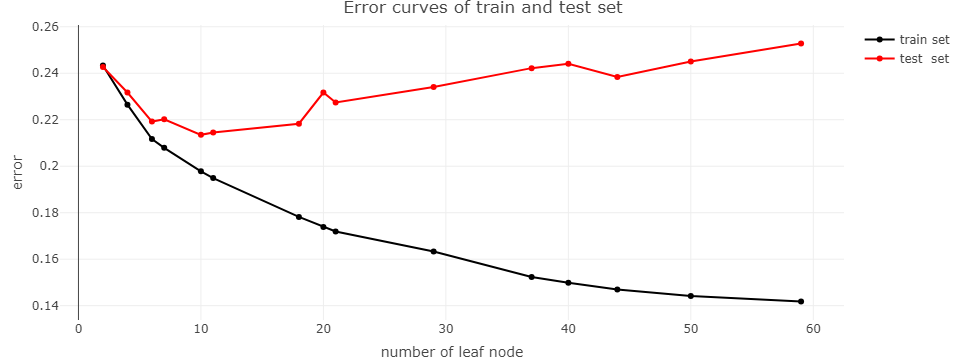

In [15]:
cp <- ctab$cp
a <- cp[, 1] # cp序列
L <- length(a)
Cp <- sqrt(a[-L] * a[-1]) # 几何平均值--二个界值之间的值
node <- cp[-1, 2] + 1 # 叶节点个数序列

error_train <- c()
error_test <- c()

for (c in Cp) # 依次画出各个cp下的决策树，计算当时的训练集和测试集错误率
{
  ct <- rpart(Rings ~ ., data = train_ab, method = "class", cp = c)
  # rpart.plot(twf,main=paste('CP=',round(c,4)))    #当前cp值对应的决策树

  pred_tr <- predict(ct, train_ab, type = "class")
  error_train <- c(error_train, mean(pred_tr != train_ab$Rings))

  pred_te <- predict(ct, test_ab, type = "class")
  error_test <- c(error_test, mean(pred_te != test_ab$Rings))
}

p_load(plotly)

fig <- plot_ly(x = Cp) %>% 
add_trace(y = error_train, type = "scatter", name = "train set", color = I("black"), mode = "lines+markers")%>%
add_trace(y = error_test, type = "scatter", name = "test  set", color = I("red"), mode = "lines+markers")%>%
layout(
  title = "Error curves of train and test set",
  xaxis = list(title = "cp"),
  yaxis = list(title = "error")
)
fig
#可见当cp值为0.0049时(左起第5个点)，test set的error达到最低

cat("\n\n")

fig <- plot_ly(x = node) %>% 
add_trace(y = error_train, type = "scatter", name = "train set", color = I("black"), mode = "lines+markers")%>%
add_trace(y = error_test, type = "scatter", name = "test  set", color = I("red"), mode = "lines+markers")%>%
layout(
  title = "Error curves of train and test set",
  xaxis = list(title = "number of leaf node"),
  yaxis = list(title = "error")
)
fig
#可见当number of leaf node值为11时((右起第5个点)，test set的error最低

可见cp值为0.0062时，test set的error最低，对照下图，0.0062在最低xerror的1-SE范围内,说明xerror 1-SE原则可以用以最优cp值的认定。

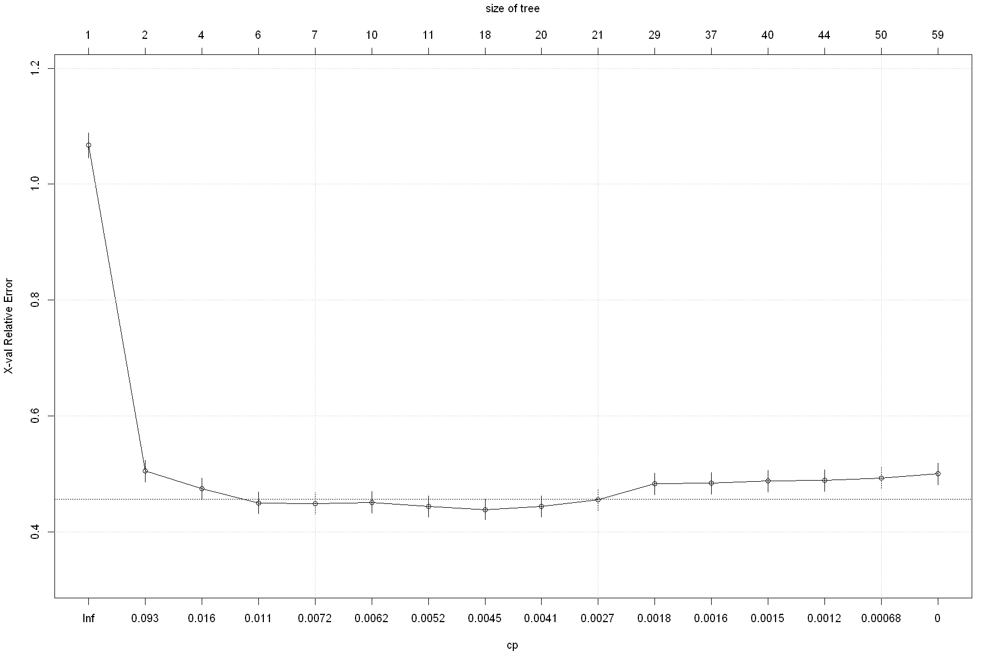

In [16]:
plotcp(ctab)
grid()

#### 多类别：分成二个以上类别

In [17]:
library(pacman)

options(warn=-1)    #忽略一切警告
options('width'=140)  #充分利用打印宽度
options(repr.plot.width=15, repr.plot.height=10)  #满幅
p_load(rattle)
p_load(rpart)
p_load(skimr)
s <- skim_tee

In [18]:
s(iris)

── Data Summary ────────────────────────
                           Values
Name                       data  
Number of rows             150   
Number of columns          5     
_______________________          
Column type frequency:           
  factor                   1     
  numeric                  4     
________________________         
Group variables            None  

── Variable type: factor ───────────────────────────────────────────────────────────────────────────────────────────────────────────────────
  skim_variable n_missing complete_rate ordered n_unique top_counts               
1 Species               0             1 FALSE          3 set: 50, ver: 50, vir: 50

── Variable type: numeric ──────────────────────────────────────────────────────────────────────────────────────────────────────────────────
  skim_variable n_missing complete_rate mean    sd  p0 p25  p50 p75 p100 hist 
1 Sepal.Length          0             1 5.84 0.828 4.3 5.1 5.8  6.4  7.9 ▆▇▇▅▂
2 Sepal.Wid

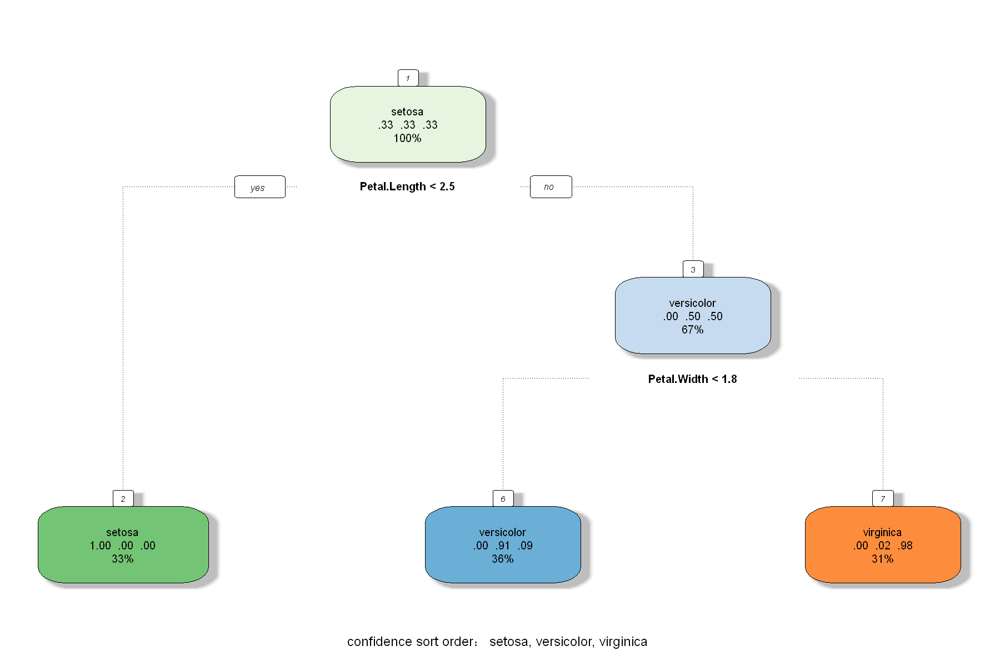

In [19]:
t <- rpart(Species ~ .,data = iris) 
fancyRpartPlot(t, caption = paste("confidence sort order：",toString(levels(iris$Species)))) 

### 例2 回归：无缺失值、特征混合取值。

　　根据一系列特征推测abalone的年龄值。

   
理论参见：
   
- https://zhuanlan.zhihu.com/p/139519852
- https://zhuanlan.zhihu.com/p/82054400

In [20]:
library(pacman)

options(warn = -1) # 忽略一切警告
options("width" = 140) # 充分利用打印宽度
options(repr.plot.width = 15, repr.plot.height = 10) # 满幅

p_load(rpart)
p_load(rattle)    #使用其中的fancyRpartPlot函数
p_load(skimr)
s <- skim_tee
p_load(AppliedPredictiveModeling)

In [21]:
data(abalone)
ab <- abalone
s(ab)

── Data Summary ────────────────────────
                           Values
Name                       data  
Number of rows             4177  
Number of columns          9     
_______________________          
Column type frequency:           
  factor                   1     
  numeric                  8     
________________________         
Group variables            None  

── Variable type: factor ───────────────────────────────────────────────────────────────────────────────────────────────────────────────────
  skim_variable n_missing complete_rate ordered n_unique top_counts               
1 Type                  0             1 FALSE          3 M: 1528, I: 1342, F: 1307

── Variable type: numeric ──────────────────────────────────────────────────────────────────────────────────────────────────────────────────
  skim_variable n_missing complete_rate  mean     sd     p0    p25   p50    p75   p100 hist 
1 LongestShell          0             1 0.524 0.120  0.075  0.45   0.545  0.

In [22]:
#将数据集1:1随机分割成训练集和测试集
set.seed(100)
I <- sample(nrow(ab),nrow(ab)*0.5)
train_ab <- ab[I,]
test_ab <- ab[-I,]
s(train_ab)

── Data Summary ────────────────────────
                           Values
Name                       data  
Number of rows             2088  
Number of columns          9     
_______________________          
Column type frequency:           
  factor                   1     
  numeric                  8     
________________________         
Group variables            None  

── Variable type: factor ───────────────────────────────────────────────────────────────────────────────────────────────────────────────────
  skim_variable n_missing complete_rate ordered n_unique top_counts            
1 Type                  0             1 FALSE          3 M: 776, I: 675, F: 637

── Variable type: numeric ──────────────────────────────────────────────────────────────────────────────────────────────────────────────────
  skim_variable n_missing complete_rate  mean     sd     p0    p25   p50    p75   p100 hist 
1 LongestShell          0             1 0.525 0.120  0.13   0.45   0.545  0.615  0

In [23]:
set.seed(2)    #固定xstd：xerror具有随机性--数据随机分割的原因
rtab <- rpart(Rings ~ .,data = train_ab, cp = 0)   #cp=0--决策树充分生长，保留该值以上cp的情形
summary(rtab)

Call:
rpart(formula = Rings ~ ., data = train_ab, cp = 0)
  n= 2088 

              CP nsplit rel error    xerror       xstd
1   2.829878e-01      0 1.0000000 1.0008968 0.04462426
2   6.164183e-02      1 0.7170122 0.7334586 0.03659775
3   3.222808e-02      2 0.6553704 0.6794031 0.03385393
4   2.757919e-02      3 0.6231423 0.6483017 0.03316818
5   2.714967e-02      5 0.5679839 0.6435810 0.03336013
6   1.277734e-02      6 0.5408343 0.6151264 0.03240589
7   1.220290e-02      7 0.5280569 0.5998887 0.03089123
8   1.169223e-02      8 0.5158540 0.5982841 0.03098841
9   1.038880e-02      9 0.5041618 0.5952278 0.03130544
10  9.764297e-03     10 0.4937730 0.5739118 0.03039389
11  9.319823e-03     11 0.4840087 0.5725903 0.03045236
12  5.319864e-03     12 0.4746889 0.5702423 0.03040234
13  4.918587e-03     13 0.4693690 0.5580921 0.03007321
14  4.727262e-03     14 0.4644504 0.5586931 0.02990142
15  4.337075e-03     15 0.4597232 0.5640507 0.03006963
16  4.139288e-03     17 0.4510490 0.5630345 0.0301

- improve is of a split SST − (SSL + SSR), SST is the sum of square errors for the node, and SSR, SSL are the sums of square errors for the right and left son
- The error of a node is the variance of y 

In [24]:
rtab$method   #method取值

[1] "anova"

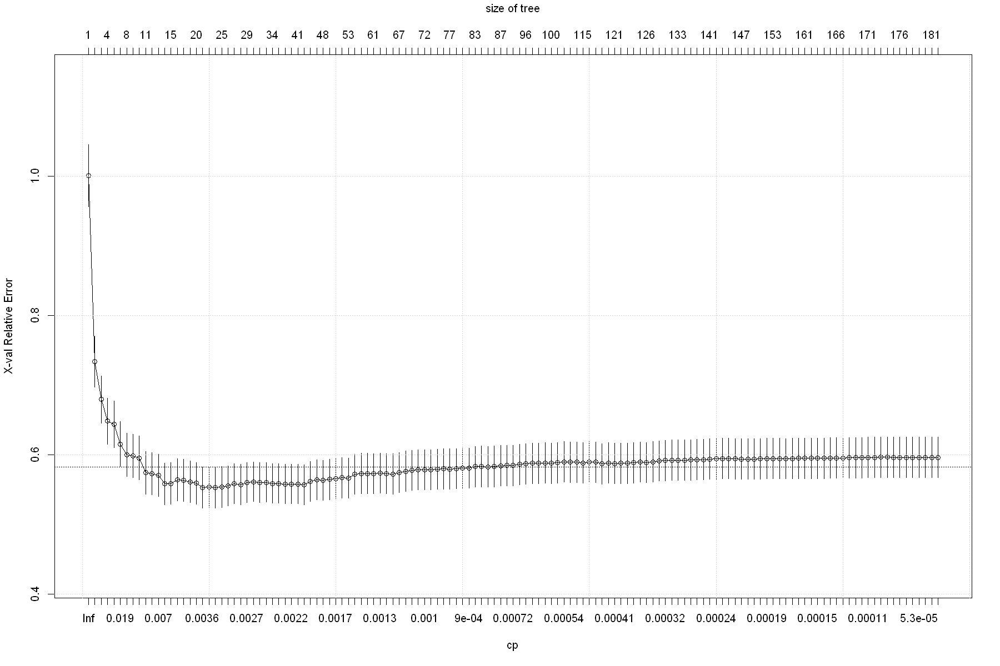

In [25]:
plotcp(rtab)   #随着cp的变化，决策树的error变化情况
grid()

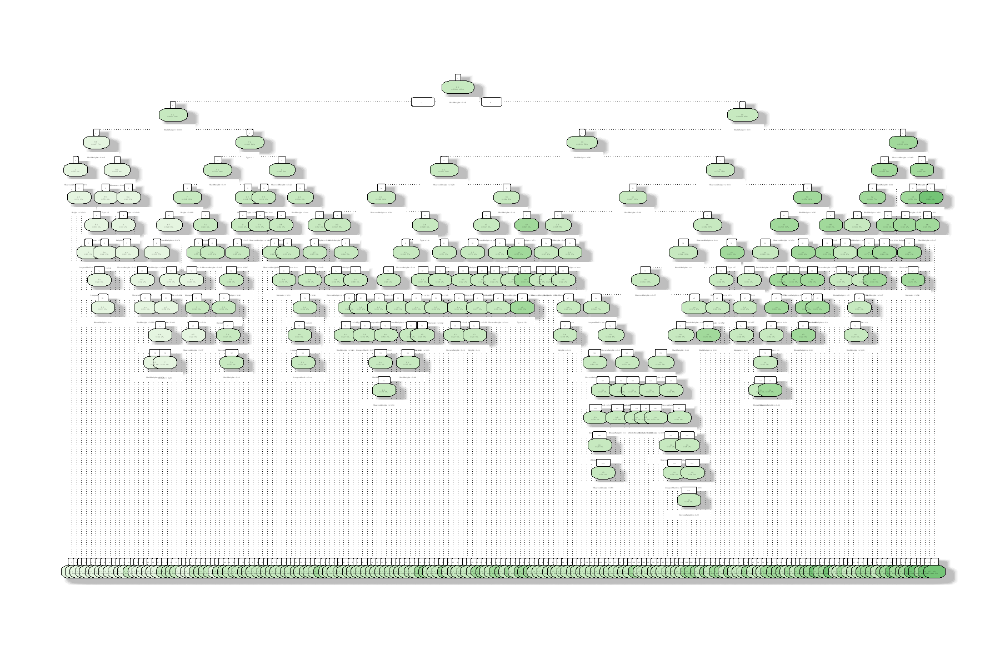

In [26]:
fancyRpartPlot(rtab, caption = "")

由xerror认定的最优决策树

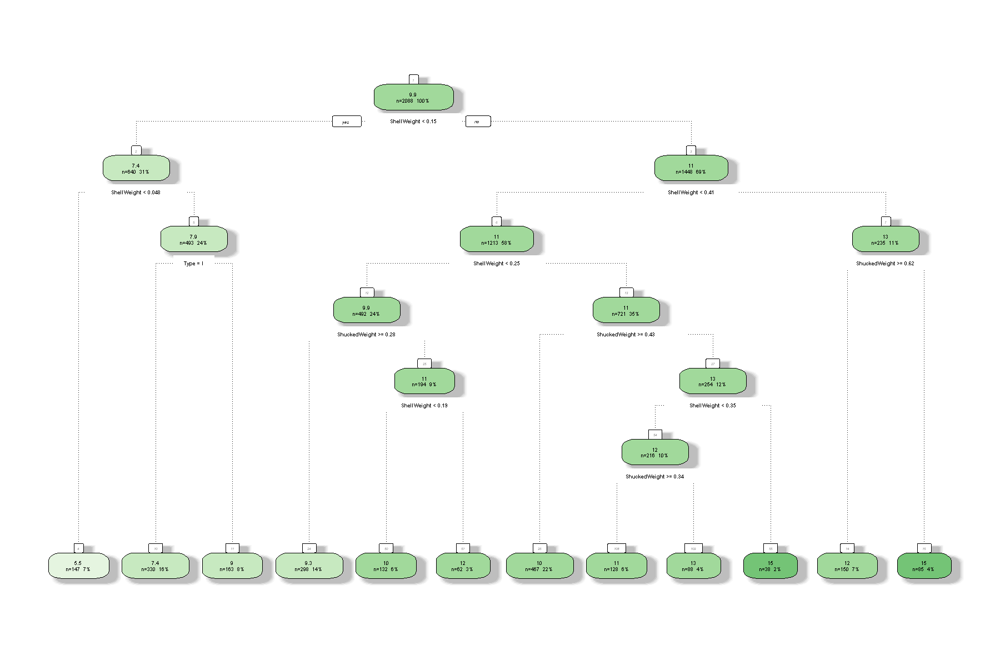

In [27]:
#根据1-SE原则，最优cp=0.0097
rtabo <- rpart(Rings ~ .,data = train_ab, cp = 0.0097)  
fancyRpartPlot(rtabo, caption = "")

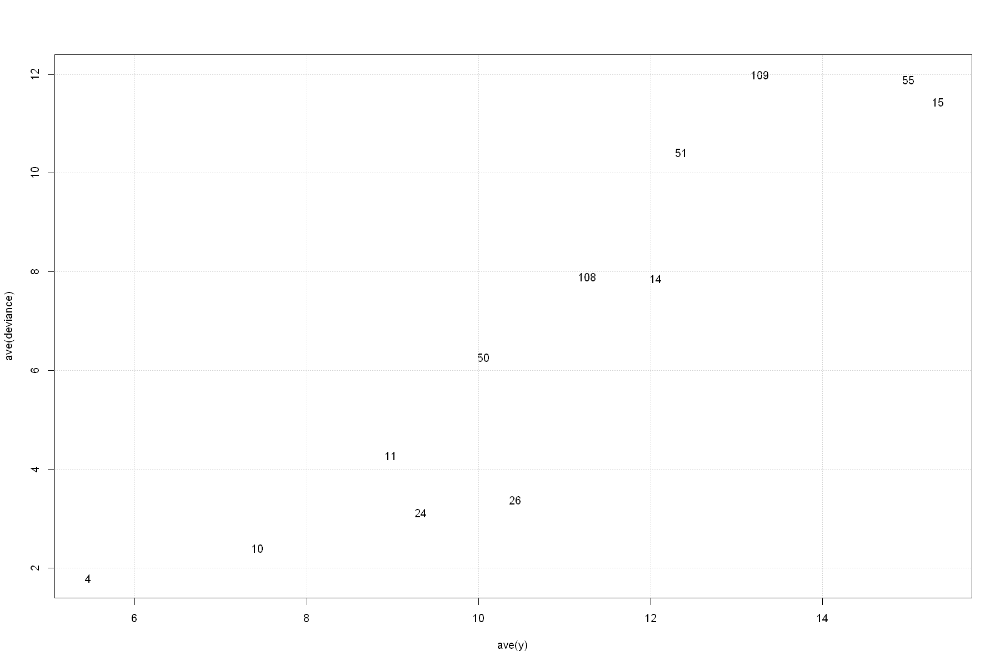

In [28]:
#各个叶节点的拟合值(横轴)以及偏差(纵轴-均方差)情况
meanvar(rtabo)
grid()

各叶节点残差的分布情况--residuals函数

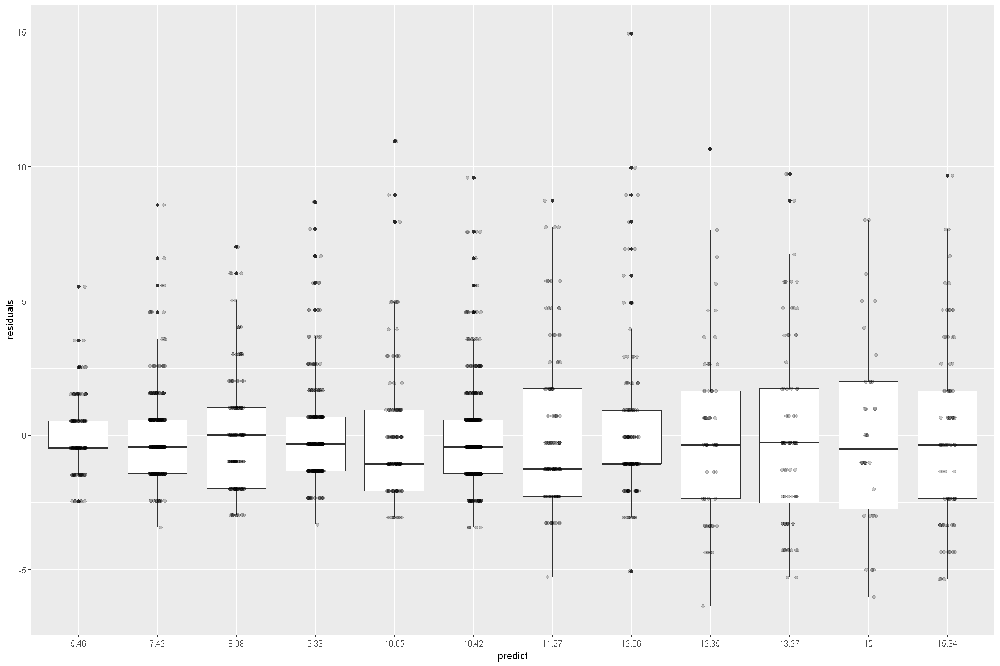

In [29]:
p_load(tidyverse)
data.frame(predict = ordered(round(predict(rtabo), digit = 2)), residuals = residuals(rtabo)) %>%
  ggplot(aes(x = predict, y = residuals)) +
  geom_boxplot() +
  geom_jitter(width = 0.1, alpha = 0.2)

错误率－最优决策树

In [30]:
pred_tr <- predict(rtabo, train_ab)      #训练集的预测值
(error_train <- sqrt(mean((pred_tr- train_ab$Rings)^2)))  #针对于训练集的RMSE
pred_te <- predict(rtabo, test_ab)       #测试集的预测值
(error_test <- sqrt(mean((pred_te- test_ab$Rings)^2)))  #针对于训练集的RMSE

[1] 2.233211

[1] 2.373074

**cp对回归性能的影响：**

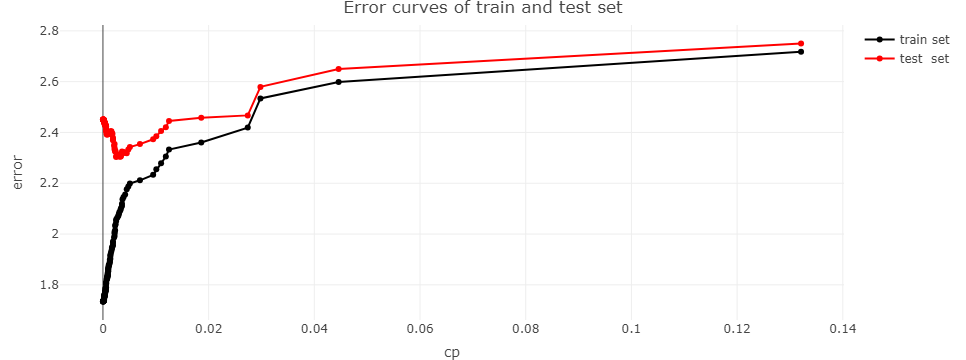

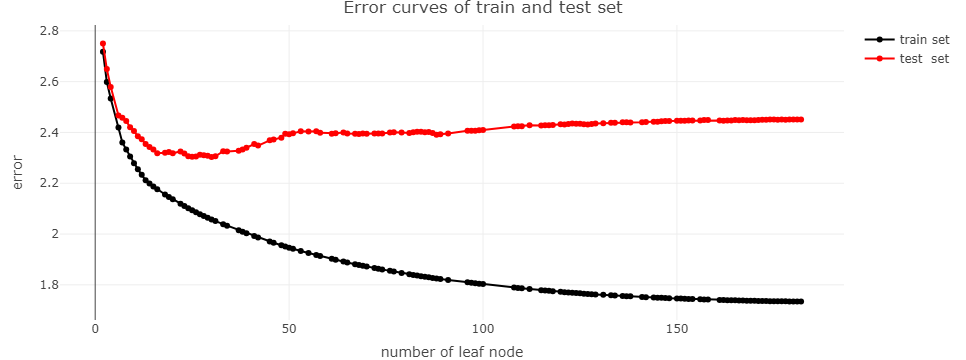

In [31]:
cp <- rtab$cp
a <- cp[, 1] # cp序列
L <- length(a)
Cp <- sqrt(a[-L] * a[-1]) # 几何平均值--二个界值之间的值
node <- cp[-1, 2] + 1 # 叶节点个数序列

error_train <- c()
error_test <- c()

for (c in Cp) # 依次画出各个cp下的决策树，计算当时的训练集和测试集错误率
{
  rt <- rpart(Rings ~ ., data = train_ab, cp = c)
  # rpart.plot(twf,main=paste('CP=',round(c,4)))    #当前cp值对应的决策树

  pred_tr <- predict(rt, train_ab)
  error_train <- c(error_train, sqrt(mean((pred_tr- train_ab$Rings)^2)))

  pred_te <- predict(rt, test_ab)
  error_test <- c(error_test, sqrt(mean((pred_te- test_ab$Rings)^2)))
}

p_load(plotly)

fig <- plot_ly(x = Cp) %>% 
add_trace(y = error_train, type = "scatter", name = "train set", color = I("black"), mode = "lines+markers")%>%
add_trace(y = error_test, type = "scatter", name = "test  set", color = I("red"), mode = "lines+markers")%>%
layout(
  title = "Error curves of train and test set",
  xaxis = list(title = "cp"),
  yaxis = list(title = "error")
)
fig

cat("\n\n")

fig <- plot_ly(x = node) %>% 
add_trace(y = error_train, type = "scatter", name = "train set", color = I("black"), mode = "lines+markers")%>%
add_trace(y = error_test, type = "scatter", name = "test  set", color = I("red"), mode = "lines+markers")%>%
layout(
  title = "Error curves of train and test set",
  xaxis = list(title = "number of leaf node"),
  yaxis = list(title = "error")
)
fig


可见cp值为0.0025时，test set的error最低，在xerror 1-SE范围内

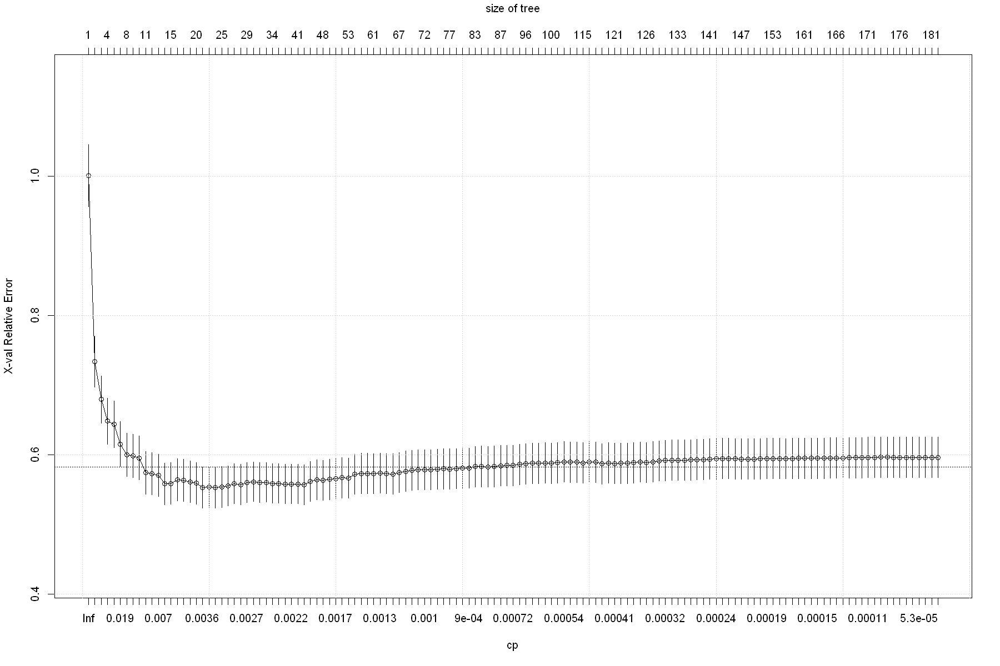

In [32]:
plotcp(rtab)   #随着cp的变化，决策树的error变化情况
grid()

### 例3 分类：非平衡、代价敏感、无缺失值

　将原abalone数据集改造成H、L二个类别非平衡的分类问题数据集，根据一系列特征，判断abalone年龄的类别，Rings为目标属性--**类别值**，特征混合取值--**既有离散取值，也有连续取值**。　

　数据集非平衡即数据集中目标变量各个类别的占比悬殊--分类器容易“偷懒”地将所有样例认定为占比高的类别从而获得低的错判率。

　rpart包采用Altered priors法(根据损失比改变各类别样例的分布)实现代价敏感算法。

In [33]:
library(pacman)

options(warn = -1) # 忽略一切警告
options("width" = 140) # 充分利用打印宽度
options(repr.plot.width = 15, repr.plot.height = 10) # 满幅

p_load(rpart)
p_load(rattle)    #使用其中的fancyRpartPlot函数
p_load(rpart.plot)
p_load(skimr)
s <- skim_tee
p_load(AppliedPredictiveModeling)

In [34]:
data(abalone)
abi <- abalone
abi$Rings <- factor((abi$Rings) > 22, labels = c("L", "H")) # 处理成占比悬殊的二类
s(abi)
#可见目标属性Rings的H类只占16/4177=0.38%,该数据集是典型的非平衡

── Data Summary ────────────────────────
                           Values
Name                       data  
Number of rows             4177  
Number of columns          9     
_______________________          
Column type frequency:           
  factor                   2     
  numeric                  7     
________________________         
Group variables            None  

── Variable type: factor ───────────────────────────────────────────────────────────────────────────────────────────────────────────────────
  skim_variable n_missing complete_rate ordered n_unique top_counts               
1 Type                  0             1 FALSE          3 M: 1528, I: 1342, F: 1307
2 Rings                 0             1 FALSE          2 L: 4161, H: 16           

── Variable type: numeric ──────────────────────────────────────────────────────────────────────────────────────────────────────────────────
  skim_variable n_missing complete_rate  mean     sd     p0    p25   p50   p75  p100 h

**代价不敏感时**

In [35]:
set.seed(2)    #固定xstd：xerror具有随机性--数据随机分割的原因
ctabi <- rpart(Rings ~ .,data = abi, method = "class", cp = 0)   #cp=0--取消cp在模型复杂度上的约束
summary(ctabi)

Call:
rpart(formula = Rings ~ ., data = abi, method = "class", cp = 0)
  n= 4177 

  CP nsplit rel error xerror xstd
1  0      0         1      0    0

Node number 1: 4177 observations
  predicted class=L  expected loss=0.0038305  P(node) =1
    class counts:  4161    16
   probabilities: 0.996 0.004 



In [36]:
ctabi$parms$loss  #其代价矩阵

0,1
1,0


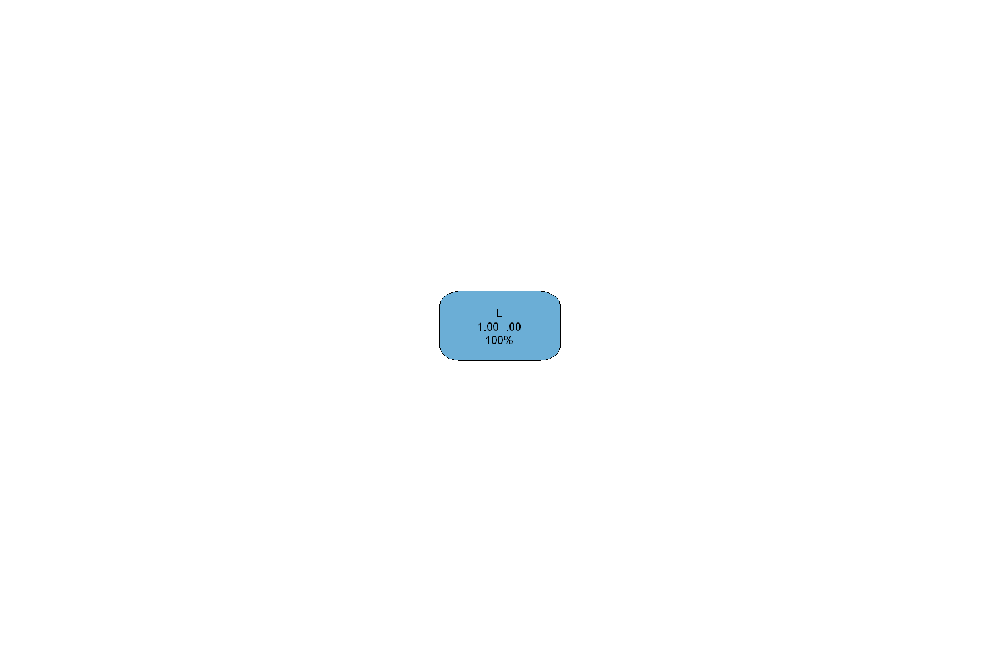

In [37]:
rpart.plot(ctabi, extra=104)    #fancyRpartPlot报错

可见代价不敏感时，决策树简单地将所有样例判为L类，expected loss=0.0038305

**代价敏感** 

将L判为H损失为1，将H判为L损失为10

In [38]:
set.seed(2)
ctabi_cs1 <- rpart(Rings ~ ., data = abi, method = "class", cp = 0, 
                  parms = list(loss = matrix(c(0, 1, 10, 0), byrow = TRUE, nrow = 2))) 
# loss matrix中横向是实际值，纵向是判断值，类别以目标属性的levels顺序排列(L、H)，即将L判为H损失为1，将H判为L损失为10
summary(ctabi_cs1)

Call:
rpart(formula = Rings ~ ., data = abi, method = "class", parms = list(loss = matrix(c(0, 
    1, 10, 0), byrow = TRUE, nrow = 2)), cp = 0)
  n= 4177 

          CP nsplit rel error  xerror       xstd
1 0.05416667      0   1.00000 0.10000 0.02495207
2 0.04062500      3   0.83750 2.03750 0.34745486
3 0.03125000      5   0.75625 3.09375 0.43103887
4 0.02500000     14   0.44375 3.09375 0.43103887
5 0.01250000     15   0.41875 4.06875 0.49645381
6 0.00000000     17   0.39375 4.87500 0.54358278

Variable importance
  WholeWeight ShuckedWeight      Diameter   ShellWeight  LongestShell VisceraWeight        Height 
           20            17            17            14            13            11             6 

Node number 1: 4177 observations,    complexity param=0.05416667
  predicted class=L  expected loss=0.038305  P(node) =1
    class counts:  4161    16
   probabilities: 0.996 0.004 
  left son=2 (4034 obs) right son=3 (143 obs)
  Primary splits:
      ShellWeight   < 0.50925 to t

为何CP列表中第一行的xerror很小(0.10000)，大大低于rel_error(1.00000),第二行迅速增大(2.03750)?不知道怎么计算出来的

In [39]:
ctabi_cs1$parms$loss  #其loss矩阵 

0,1
10,0


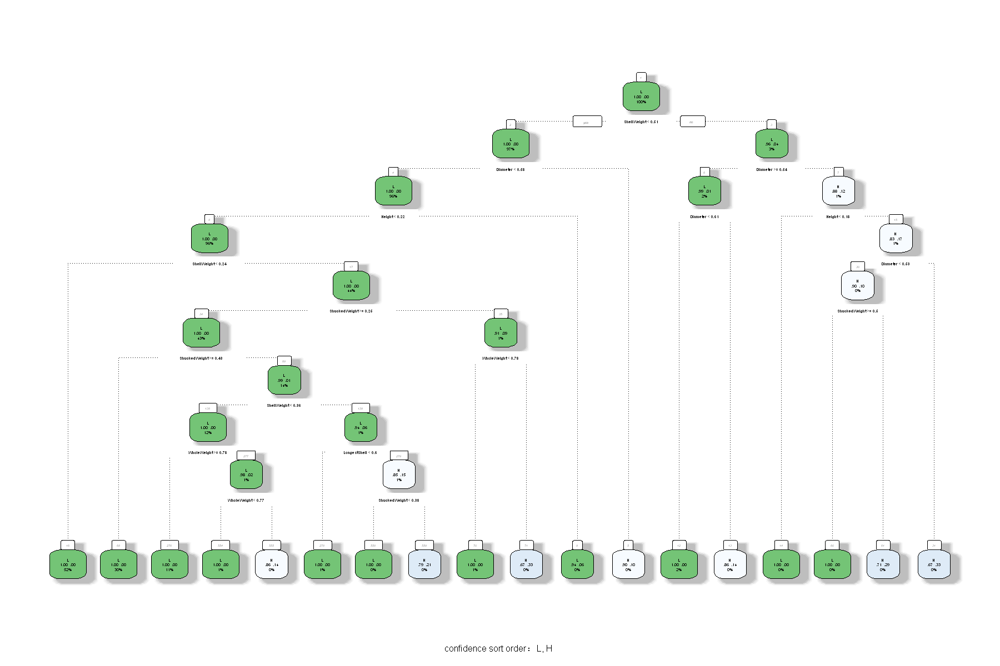

In [40]:
fancyRpartPlot(ctabi_cs1, caption = paste("confidence sort order：",toString(levels(abi$Rings))))

In [41]:
#进一步增大将H判为L损失
set.seed(2)
ctabi_cs2 <- rpart(Rings ~ ., data = abi, method = "class", cp = 0, 
                  parms = list(loss = matrix(c(0, 1, 100, 0), byrow = TRUE, nrow = 2))) 
# loss matrix中横向是实际值，纵向是判断值，类别以目标属性的levels顺序排列(L、H)，即将L判为H损失为1，将H判为L损失为100
summary(ctabi_cs2)

Call:
rpart(formula = Rings ~ ., data = abi, method = "class", parms = list(loss = matrix(c(0, 
    1, 100, 0), byrow = TRUE, nrow = 2)), cp = 0)
  n= 4177 

          CP nsplit rel error    xerror        xstd
1  0.2737500      0  1.000000  0.010000 0.002495207
2  0.1503125      1  0.726250 34.945000 1.375226070
3  0.0906250      3  0.425625 16.693750 0.988055974
4  0.0381250      5  0.244375 22.880000 1.142087029
5  0.0318750      6  0.206250 17.943750 1.021770064
6  0.0300000      7  0.174375 14.320000 0.919479588
7  0.0181250      8  0.144375 12.382500 0.858332633
8  0.0175000     10  0.108125  9.882500 0.770591240
9  0.0156250     11  0.090625  8.008125 0.696169475
10 0.0075000     13  0.059375  5.758125 0.592825710
11 0.0056250     14  0.051875  5.445625 0.576844238
12 0.0050000     15  0.046250  5.008125 0.553624831
13 0.0028125     16  0.041250  4.695625 0.536372244
14 0.0000000     18  0.035625  4.383125 0.518500874

Variable importance
  WholeWeight   ShellWeight  LongestShell

为何CP列表中第一行的xerror很小(0.01000)，大大低于rel_error(1.00000),第二行迅速增大(34.945000)?不知道怎么计算出来的

In [42]:
ctabi_cs2$parms$loss 

0,1
100,0


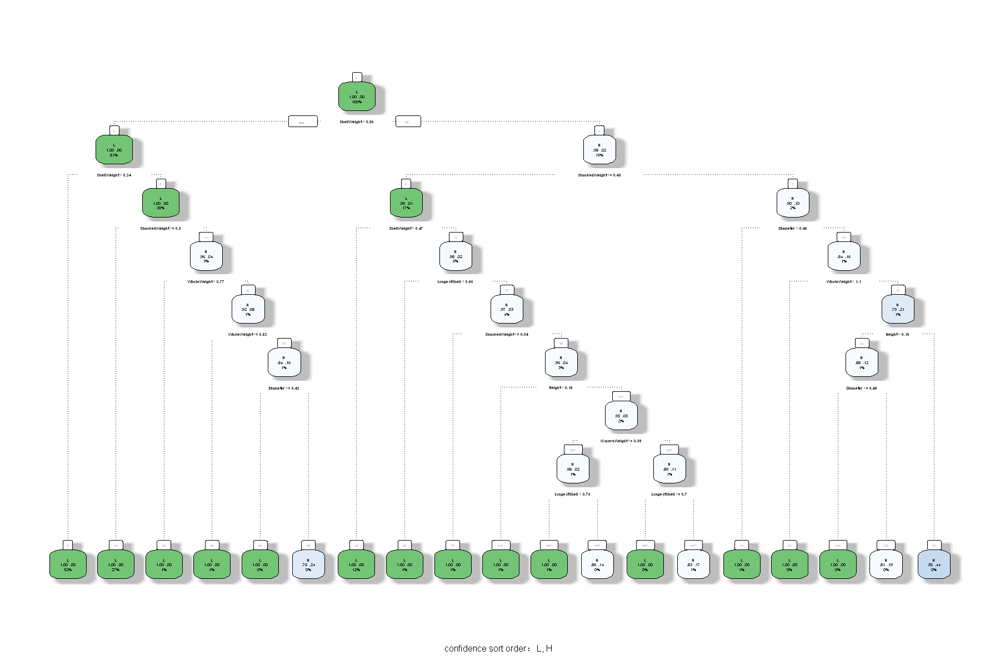

In [43]:
fancyRpartPlot(ctabi_cs2, caption = paste("confidence sort order：",toString(levels(abi$Rings)))) 

In [44]:
#继续增大将H判为L损失
set.seed(2)
ctabi_cs3 <- rpart(Rings ~ ., data = abi, method = "class", cp = 0, 
                  parms = list(loss = matrix(c(0, 1, 1000, 0), byrow = TRUE, nrow = 2))) 
# loss matrix中横向是实际值，纵向是判断值，类别以目标属性的levels顺序排列(L、H)，即将L判为H损失为1，将H判为L损失为1000
summary(ctabi_cs3)

Call:
rpart(formula = Rings ~ ., data = abi, method = "class", parms = list(loss = matrix(c(0, 
    1, 1000, 0), byrow = TRUE, nrow = 2)), cp = 0)
  n= 4177 

            CP nsplit  rel error     xerror      xstd
1  0.519346311      0 1.00000000 1000.00000 0.9594645
2  0.101818473      1 0.48065369  473.20404 7.7533974
3  0.025234319      4 0.17519827  184.57270 6.0167680
4  0.012016342      8 0.07426099   86.76087 4.3644194
5  0.011535689      9 0.06224465   58.64263 3.6427186
6  0.006248498     10 0.05070896   47.34727 3.2926336
7  0.006008171     11 0.04446047   40.13747 3.0429806
8  0.004726428     12 0.03845230   40.13747 3.0429806
9  0.004325883     15 0.02427301   32.44701 2.7468429
10 0.002643595     16 0.01994713   18.50805 2.0893255
11 0.001922615     17 0.01730353   18.02740 2.0625157
12 0.001081471     18 0.01538092   15.62413 1.9224367
13 0.000000000     20 0.01321798   14.66282 1.8632513

Variable importance
  ShellWeight   WholeWeight      Diameter  LongestShell VisceraW

为何CP列表中第一行的xerror很大(1000.00000 )，大大于rel_error(1.00000)，不知道怎么计算出来的

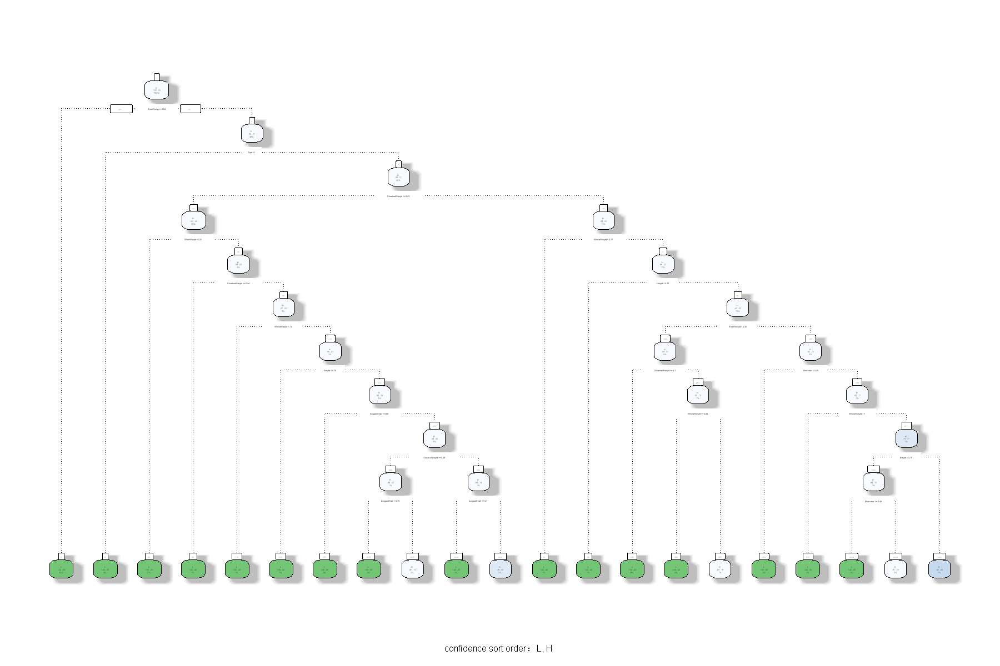

In [45]:
fancyRpartPlot(ctabi_cs3, caption = paste("confidence sort order：",toString(levels(abi$Rings))))

### 例4 Poisson回归：将计数值作为回归的目标

   
理论参见：
   
- https://zhuanlan.zhihu.com/p/104494467
- https://mengte.online/archives/4373

In [46]:
library(pacman)

options(warn = -1) # 忽略一切警告
options("width" = 140) # 充分利用打印宽度
options(repr.plot.width = 15, repr.plot.height = 10) # 满幅

p_load(rpart)
p_load(rattle)    #使用其中的fancyRpartPlot函数
p_load(skimr)
s <- skim_tee

In [47]:
s(solder.balance)

── Data Summary ────────────────────────
                           Values
Name                       data  
Number of rows             720   
Number of columns          6     
_______________________          
Column type frequency:           
  factor                   4     
  numeric                  2     
________________________         
Group variables            None  

── Variable type: factor ───────────────────────────────────────────────────────────────────────────────────────────────────────────────────
  skim_variable n_missing complete_rate ordered n_unique top_counts                         
1 Opening               0             1 FALSE          3 L: 240, M: 240, S: 240             
2 Solder                0             1 FALSE          2 Thi: 360, Thi: 360                 
3 Mask                  0             1 FALSE          4 A1.: 180, A3: 180, B3: 180, B6: 180
4 PadType               0             1 FALSE         10 D4: 72, D6: 72, D7: 72, L4: 72     

── Variable

In [48]:
sfit <- rpart(skips ~ Opening + Solder + Mask + PadType + Panel,data = solder.balance, method = 'poisson')

In [49]:
summary(sfit)

Call:
rpart(formula = skips ~ Opening + Solder + Mask + PadType + Panel, 
    data = solder.balance, method = "poisson")
  n= 720 

           CP nsplit rel error    xerror       xstd
1  0.36602468      0 1.0000000 1.0019988 0.06422219
2  0.14356853      1 0.6339753 0.6387025 0.03708533
3  0.07081271      2 0.4904068 0.4966136 0.02704405
4  0.05274593      3 0.4195941 0.4254495 0.02279566
5  0.04996799      4 0.3668481 0.3943515 0.02121493
6  0.03398865      5 0.3168802 0.3227273 0.01757270
7  0.02282681      6 0.2828915 0.2888792 0.01615763
8  0.01275728      7 0.2600647 0.2717003 0.01480997
9  0.01152481      8 0.2473074 0.2741689 0.01453543
10 0.01120879      9 0.2357826 0.2687010 0.01435964
11 0.01000000     10 0.2245738 0.2617161 0.01398182

Variable importance
Opening    Mask  Solder PadType 
     47      28      19       6 

Node number 1: 720 observations,    complexity param=0.3660247
  events=3575,  estimated rate=4.965278 , mean deviance=9.521792 
  left son=2 (480 obs) righ

improve--The likelihood ratio test for two Poisson groups: D<sub>parent</sub>- (D<sub>left</sub> + D<sub>right</sub>)

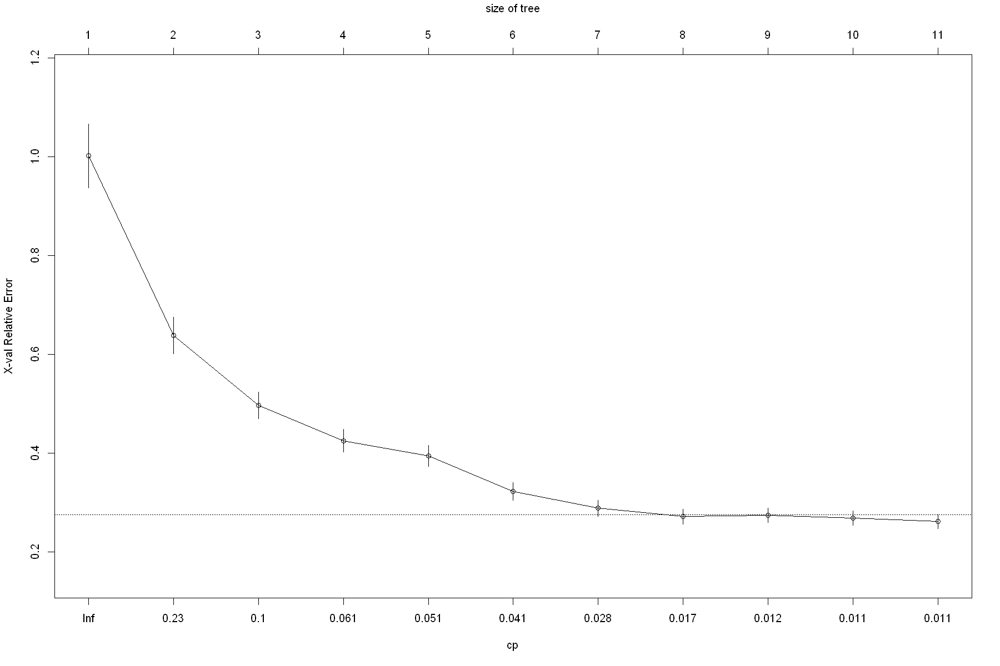

In [50]:
plotcp(sfit)

In [51]:
sfito <- rpart(skips ~ Opening + Solder + Mask + PadType + Panel,data = solder.balance, 
              method = 'poisson', cp = 0.017)

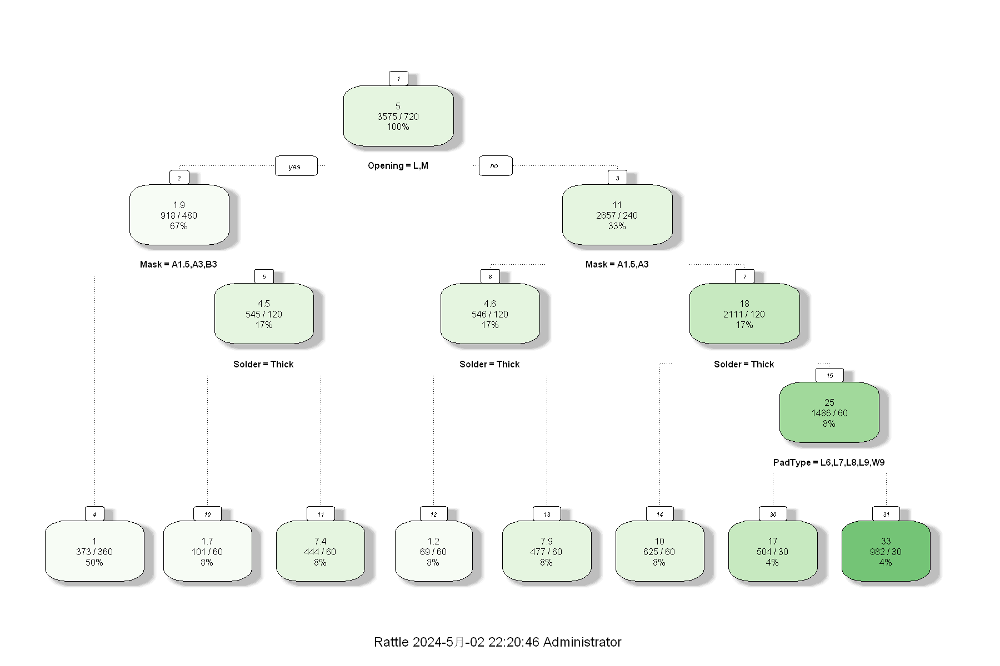

In [52]:
fancyRpartPlot(sfito)

###  例5 生存分析：一类特殊的Possion回归

   
理论参见：
   
- https://www.cnblogs.com/wwxbi/p/6136348.html
- http://thisis.yorven.site/blog/index.php/2020/04/06/survival-analysis/

In [53]:
library(pacman)

options(warn = -1) # 忽略一切警告
options("width" = 140) # 充分利用打印宽度
options(repr.plot.width = 15, repr.plot.height = 10) # 满幅
p_load(rpart.plot)
p_load(rpart)
p_load(skimr)
s <- skim_tee

In [54]:
stagec

pgtime,pgstat,age,eet,g2,grade,gleason,ploidy
<dbl>,<int>,<int>,<int>,<dbl>,<int>,<int>,<fct>
6.1,0,64,2,10.26,2,4,diploid
9.4,0,62,1,NA,3,8,aneuploid
5.2,1,59,2,9.99,3,7,diploid
3.2,1,62,2,3.57,2,4,diploid
1.9,1,64,2,22.56,4,8,tetraploid
4.8,0,69,1,6.14,3,7,diploid
5.8,0,75,2,13.69,2,NA,tetraploid
7.3,0,71,2,NA,3,7,aneuploid
3.7,1,73,2,11.77,3,6,diploid


In [55]:
s(stagec)

── Data Summary ────────────────────────
                           Values
Name                       data  
Number of rows             146   
Number of columns          8     
_______________________          
Column type frequency:           
  factor                   1     
  numeric                  7     
________________________         
Group variables            None  

── Variable type: factor ───────────────────────────────────────────────────────────────────────────────────────────────────────────────────
  skim_variable n_missing complete_rate ordered n_unique top_counts               
1 ploidy                0             1 FALSE          3 tet: 68, dip: 67, ane: 11

── Variable type: numeric ──────────────────────────────────────────────────────────────────────────────────────────────────────────────────
  skim_variable n_missing complete_rate   mean    sd   p0   p25  p50  p75 p100 hist 
1 pgtime                0         1      6.32  3.62   0.3  3.7   5.9  7.9 17.7 ▅▇▃▂▁

In [56]:
pfit <- rpart(survival::Surv(pgtime, pgstat) ~ age + eet + g2 + grade + gleason + ploidy, data = stagec)
summary(pfit)

Call:
rpart(formula = survival::Surv(pgtime, pgstat) ~ age + eet + 
    g2 + grade + gleason + ploidy, data = stagec)
  n= 146 

          CP nsplit rel error    xerror       xstd
1 0.12945955      0 1.0000000 1.0194980 0.07111250
2 0.04205598      1 0.8705405 0.9309321 0.07473863
3 0.02919986      2 0.8284845 0.9264828 0.08101054
4 0.01798864      3 0.7992846 0.9580407 0.08376493
5 0.01540577      4 0.7812960 1.0048364 0.09027298
6 0.01335393      5 0.7658902 0.9984583 0.09066265
7 0.01150598      7 0.7391823 1.0017957 0.09295270
8 0.01000000      8 0.7276764 1.0008805 0.09235124

Variable importance
  grade gleason      g2  ploidy     age     eet 
     27      25      22      13      11       2 

Node number 1: 146 observations,    complexity param=0.1294595
  events=54,  estimated rate=1 , mean deviance=1.31583 
  left son=2 (61 obs) right son=3 (85 obs)
  Primary splits:
      grade   < 2.5    to the left,  improve=24.922100, (0 missing)
      gleason < 5.5    to the left,  improve

In [57]:
pfit$method

[1] "exp"

Sur函数参数：
- time：for right censored data, this is the follow up time. For interval data, the first argument is the starting time for the interval.
- event：The status indicator, normally 0=alive, 1=dead. 

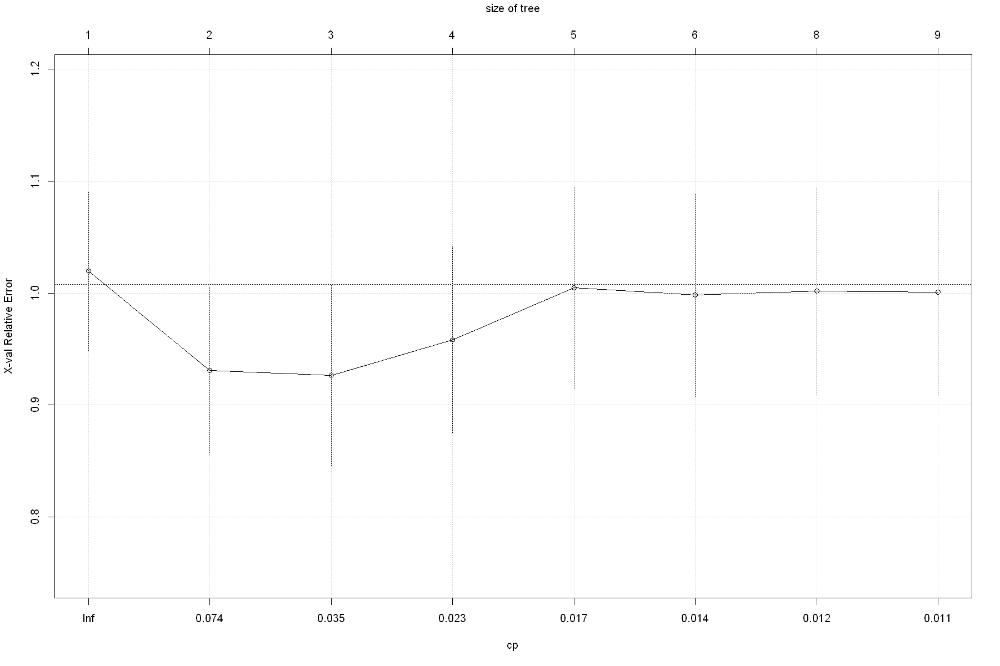

In [58]:
plotcp(pfit)
grid()

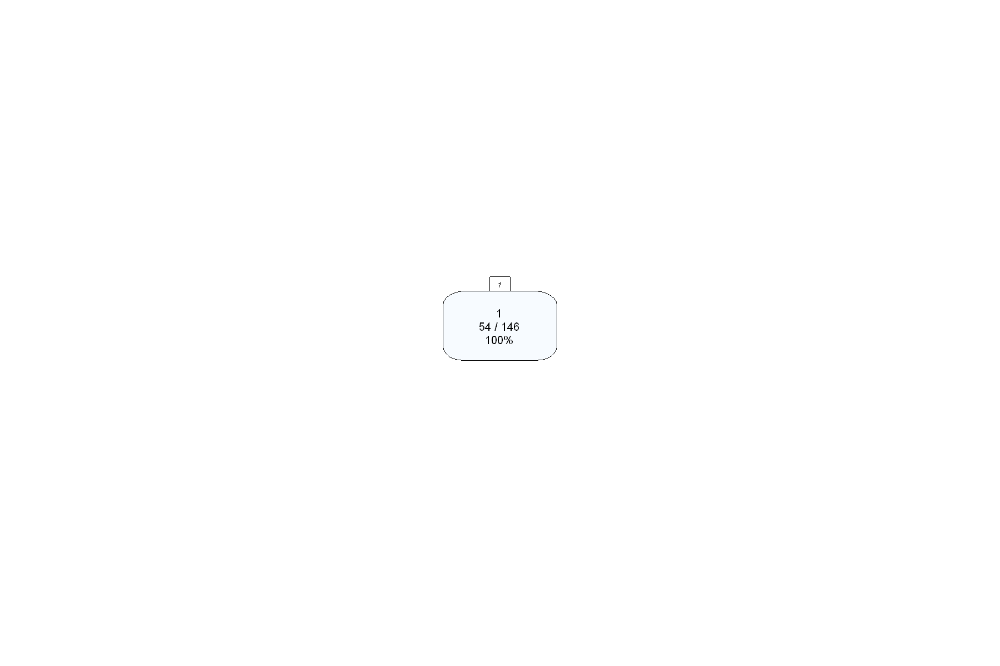

In [59]:

pfit2 <- prune(pfit, cp = 0.12945955)
rpart.plot(pfit2, nn = TRUE)
#各节点第一行、第二行数字的含义是？

,var,n,wt,dev,yval,complexity,ncompete,nsurrogate,yval2
,<chr>,<int>,<dbl>,<dbl>,<dbl>,<dbl>,<int>,<int>,"<dbl[,6]>"
1,RearEnd,3,3,1,2,1.00,0,0,"2, 1, 2, 0.3333333, 0.6666667, 1.0000000"
2,<leaf>,1,1,0,1,0.01,0,0,"1, 1, 0, 1.0000000, 0.0000000, 0.3333333"
3,<leaf>,2,2,0,2,0.01,0,0,"2, 0, 2, 0.0000000, 1.0000000, 0.6666667"


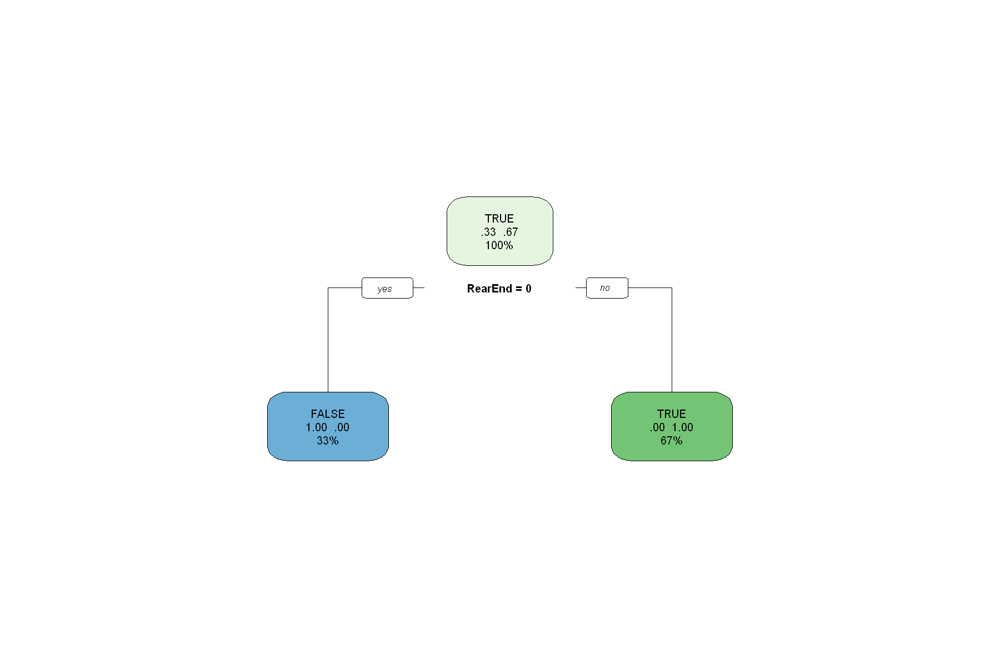

In [60]:
train <- data.frame(RearEnd = c(TRUE, FALSE, TRUE), Fraud = c(TRUE, FALSE, TRUE))
mytree <- rpart(Fraud ~ RearEnd,data = train,method = "class",minsplit = 2,minbucket = 1)
rpart.plot(mytree, extra = 104)
mytree$frame

,var,n,wt,dev,yval,complexity,ncompete,nsurrogate,yval2
,<chr>,<int>,<dbl>,<dbl>,<dbl>,<dbl>,<int>,<int>,"<dbl[,6]>"
1,RearEnd,3,0.3,0.1,2,1.00,0,0,"2, 0.1, 0.2, 0.2, 0.8, 1.0000000"
2,<leaf>,1,0.1,0.0,1,0.01,0,0,"1, 0.1, 0.0, 1.0, 0.0, 0.3333333"
3,<leaf>,2,0.2,0.0,2,0.01,0,0,"2, 0.0, 0.2, 0.0, 1.0, 0.6666667"


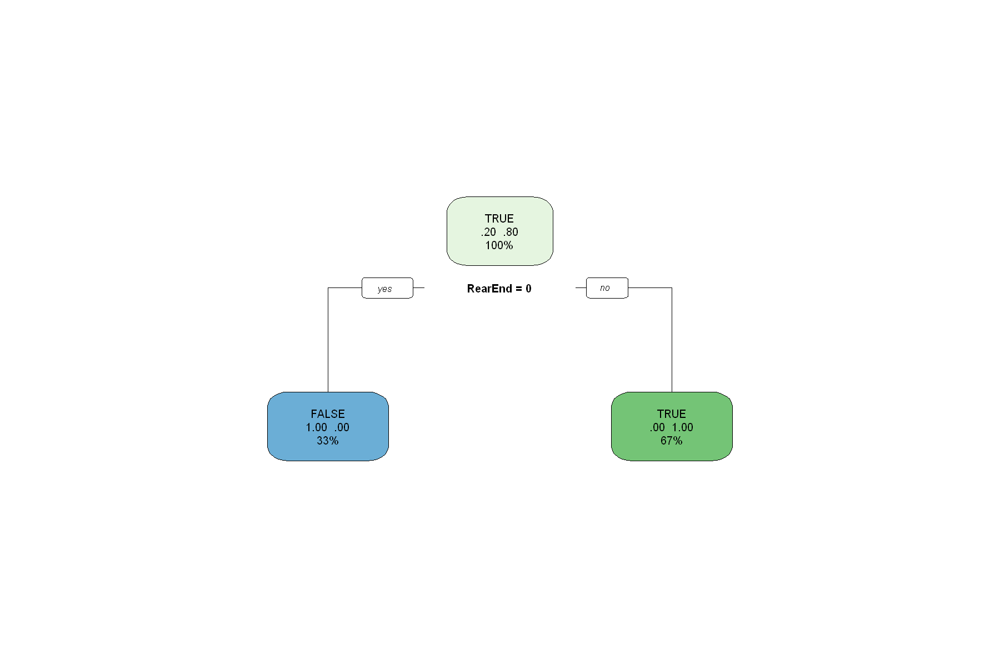

In [61]:
train <- data.frame(RearEnd = c(TRUE, FALSE, TRUE), Fraud = c(TRUE, FALSE, TRUE))
mytree <- rpart(Fraud ~ RearEnd,data = train,method = "class",minsplit = 2,minbucket = 1,
                weights = c(0.1, 0.1, 0.1))
rpart.plot(mytree, extra = 104)
mytree$frame

,var,n,wt,dev,yval,complexity,ncompete,nsurrogate,yval2
,<chr>,<int>,<dbl>,<dbl>,<dbl>,<dbl>,<int>,<int>,"<dbl[,6]>"
1,RearEnd,3,1.2,0.4,2,1.00,0,0,"2, 0.4, 0.8, 0.2, 0.8, 1.0000000"
2,<leaf>,1,0.4,0.0,1,0.01,0,0,"1, 0.4, 0.0, 1.0, 0.0, 0.3333333"
3,<leaf>,2,0.8,0.0,2,0.01,0,0,"2, 0.0, 0.8, 0.0, 1.0, 0.6666667"


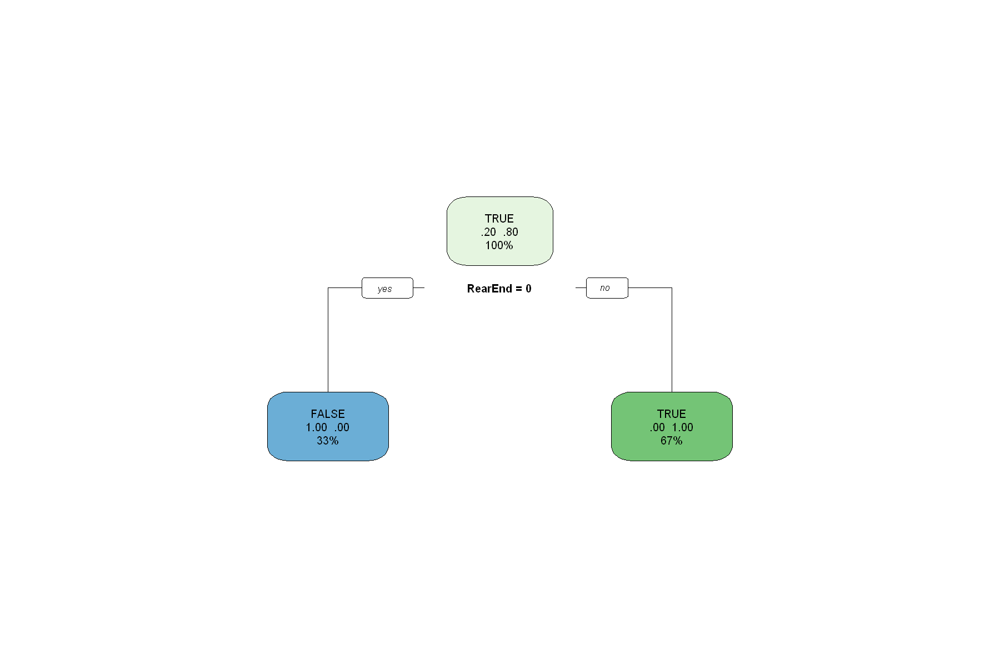

In [62]:
train <- data.frame(RearEnd = c(TRUE, FALSE, TRUE), Fraud = c(TRUE, FALSE, TRUE))
mytree <- rpart(Fraud ~ RearEnd,data = train,method = "class",minsplit = 2,minbucket = 1,
                weights = c(0.4, 0.4, 0.4))
rpart.plot(mytree, extra = 104)
mytree$frame

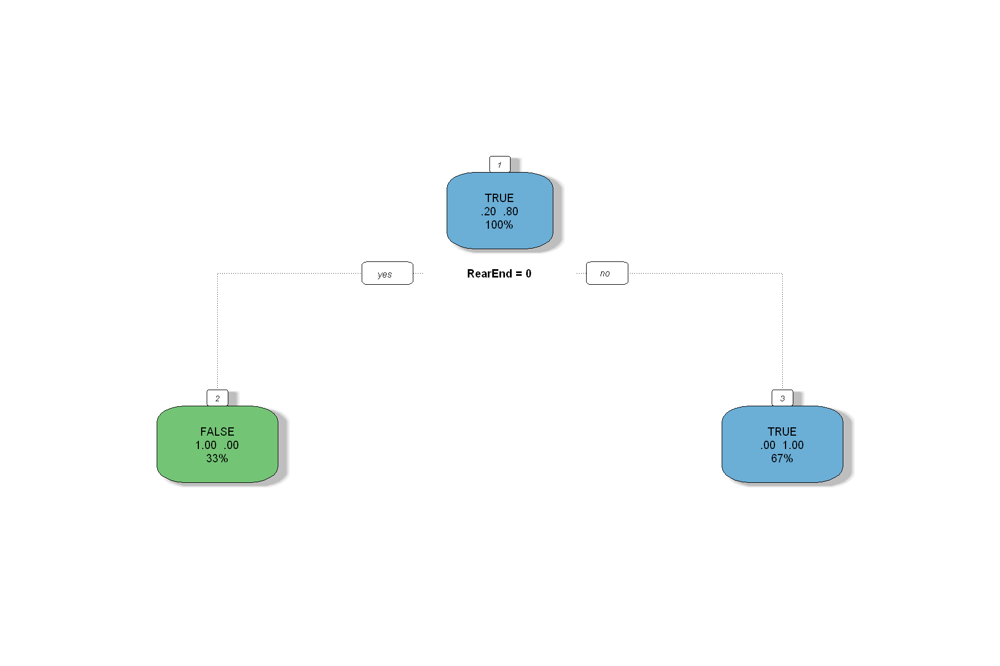

In [63]:
fancyRpartPlot(mytree, caption = "")

###  例6 缺失值处理

#### 建模时特征值缺失

In [64]:
library(pacman)

options(warn = -1) # 忽略一切警告
options("width" = 140) # 充分利用打印宽度
options(repr.plot.width = 15, repr.plot.height = 10) # 满幅

p_load(rpart)
p_load(rattle)    #使用其中的fancyRpartPlot函数
p_load(skimr)
s <- skim_tee
p_load(AppliedPredictiveModeling)

In [65]:
data(abalone)
ab <- abalone
ab$Rings <- factor((ab$Rings) > 9, labels = c("L", "H")) # 处理成二类，逻辑型factor的levels的排序默认是：FALSE,TRUE，分别对应于"L","H"
s(ab)

── Data Summary ────────────────────────
                           Values
Name                       data  
Number of rows             4177  
Number of columns          9     
_______________________          
Column type frequency:           
  factor                   2     
  numeric                  7     
________________________         
Group variables            None  

── Variable type: factor ───────────────────────────────────────────────────────────────────────────────────────────────────────────────────
  skim_variable n_missing complete_rate ordered n_unique top_counts               
1 Type                  0             1 FALSE          3 M: 1528, I: 1342, F: 1307
2 Rings                 0             1 FALSE          2 L: 2096, H: 2081         

── Variable type: numeric ──────────────────────────────────────────────────────────────────────────────────────────────────────────────────
  skim_variable n_missing complete_rate  mean     sd     p0    p25   p50   p75  p100 h

In [66]:
# 将数据集1:1随机分割成训练集和测试集
set.seed(100)
I <- sample(nrow(ab), nrow(ab) * 0.5)
train_ab <- ab[I, ]
test_ab <- ab[-I, ]
s(train_ab)

── Data Summary ────────────────────────
                           Values
Name                       data  
Number of rows             2088  
Number of columns          9     
_______________________          
Column type frequency:           
  factor                   2     
  numeric                  7     
________________________         
Group variables            None  

── Variable type: factor ───────────────────────────────────────────────────────────────────────────────────────────────────────────────────
  skim_variable n_missing complete_rate ordered n_unique top_counts            
1 Type                  0             1 FALSE          3 M: 776, I: 675, F: 637
2 Rings                 0             1 FALSE          2 L: 1044, H: 1044      

── Variable type: numeric ──────────────────────────────────────────────────────────────────────────────────────────────────────────────────
  skim_variable n_missing complete_rate  mean     sd     p0    p25   p50   p75  p100 hist 
1 Lo

In [67]:
train_ab[1,"ShellWeight"] <- NA
s(train_ab)

── Data Summary ────────────────────────
                           Values
Name                       data  
Number of rows             2088  
Number of columns          9     
_______________________          
Column type frequency:           
  factor                   2     
  numeric                  7     
________________________         
Group variables            None  

── Variable type: factor ───────────────────────────────────────────────────────────────────────────────────────────────────────────────────
  skim_variable n_missing complete_rate ordered n_unique top_counts            
1 Type                  0             1 FALSE          3 M: 776, I: 675, F: 637
2 Rings                 0             1 FALSE          2 L: 1044, H: 1044      

── Variable type: numeric ──────────────────────────────────────────────────────────────────────────────────────────────────────────────────
  skim_variable n_missing complete_rate  mean     sd     p0    p25   p50   p75  p100 hist 
1 Lo

In [68]:
with(train_ab, table(Rings,exclude = NULL))

Rings
   L    H 
1044 1044 

In [69]:
with(train_ab, table(cut(ShellWeight, c(0, 0.2545, Inf)),Rings,exclude = NULL))

             Rings
                L   H
  (0,0.254]   851 315
  (0.254,Inf] 192 729
  <NA>          1   0

In [70]:
set.seed(2)    #固定xstd：xerror具有随机性--数据随机分割的原因
ctab <- rpart(Rings ~ .,data = train_ab, method = "class", cp = 0)   #cp=0--取消cp在模型复杂度上的约束
summary(ctab)
#从各个splits(分枝)可见，其improve值逐层下降--优先选择improve大的属性作为当前的分枝属性。

Call:
rpart(formula = Rings ~ ., data = train_ab, method = "class", 
    cp = 0)
  n= 2088 

             CP nsplit rel error    xerror       xstd
1  0.5134099617      0 1.0000000 1.0670498 0.02183516
2  0.0167624521      1 0.4865900 0.5047893 0.01901258
3  0.0148467433      3 0.4530651 0.4741379 0.01861422
4  0.0076628352      5 0.4233716 0.4501916 0.01827984
5  0.0067049808      6 0.4157088 0.4492337 0.01826603
6  0.0057471264      9 0.3955939 0.4511494 0.01829362
7  0.0047892720     10 0.3898467 0.4463602 0.01822437
8  0.0043103448     17 0.3563218 0.4396552 0.01812597
9  0.0038314176     19 0.3477011 0.4463602 0.01822437
10 0.0019157088     20 0.3438697 0.4549808 0.01834840
11 0.0016762452     28 0.3266284 0.4770115 0.01865295
12 0.0015964240     36 0.3045977 0.4837165 0.01874219
13 0.0014367816     39 0.2998084 0.4932950 0.01886697
14 0.0009578544     43 0.2940613 0.4952107 0.01889155
15 0.0004789272     49 0.2883142 0.4923372 0.01885464
16 0.0000000000     58 0.2835249 0.5076628 

#### 预测时特征值缺失

In [71]:
library(pacman)

options(warn = -1) # 忽略一切警告
options("width" = 140) # 充分利用打印宽度
options(repr.plot.width = 15, repr.plot.height = 10) # 满幅

p_load(rpart)
p_load(rattle)    #使用其中的fancyRpartPlot函数
p_load(skimr)
s <- skim_tee
p_load(AppliedPredictiveModeling)

In [72]:
data(abalone)
ab <- abalone
ab$Rings <- factor((ab$Rings) > 9, labels = c("L", "H")) # 处理成二类，逻辑型factor的levels的排序默认是：FALSE,TRUE，分别对应于"L","H"

# 将数据集1:1随机分割成训练集和测试集
set.seed(100)
I <- sample(nrow(ab), nrow(ab) * 0.5)
train_ab <- ab[I, ]
test_ab <- ab[-I, ]
head(test_ab)

,Type,LongestShell,Diameter,Height,WholeWeight,ShuckedWeight,VisceraWeight,ShellWeight,Rings
,<fct>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<fct>
3,F,0.530,0.420,0.135,0.6770,0.2565,0.1415,0.210,L
7,F,0.530,0.415,0.150,0.7775,0.2370,0.1415,0.330,H
8,F,0.545,0.425,0.125,0.7680,0.2940,0.1495,0.260,H
9,M,0.475,0.370,0.125,0.5095,0.2165,0.1125,0.165,L
10,F,0.550,0.440,0.150,0.8945,0.3145,0.1510,0.320,H
12,M,0.430,0.350,0.110,0.4060,0.1675,0.0810,0.135,H


Call:
rpart(formula = Rings ~ ., data = train_ab, method = "class", 
    control = list(maxsurrogate = 7), cp = 0.2)
  n= 2088 

       CP nsplit rel error    xerror       xstd
1 0.51341      0   1.00000 1.0670498 0.02183516
2 0.20000      1   0.48659 0.5047893 0.01901258

Variable importance
  ShellWeight   WholeWeight      Diameter  LongestShell VisceraWeight ShuckedWeight        Height          Type 
           17            14            13            13            13            12            12             6 

Node number 1: 2088 observations,    complexity param=0.51341
  predicted class=L  expected loss=0.5  P(node) =1
    class counts:  1044  1044
   probabilities: 0.500 0.500 
  left son=2 (1166 obs) right son=3 (922 obs)
  Primary splits:
      ShellWeight   < 0.2545  to the left,  improve=278.9977, (0 missing)
      VisceraWeight < 0.14475 to the left,  improve=241.2211, (0 missing)
      WholeWeight   < 0.64325 to the left,  improve=237.9942, (0 missing)
      Height       

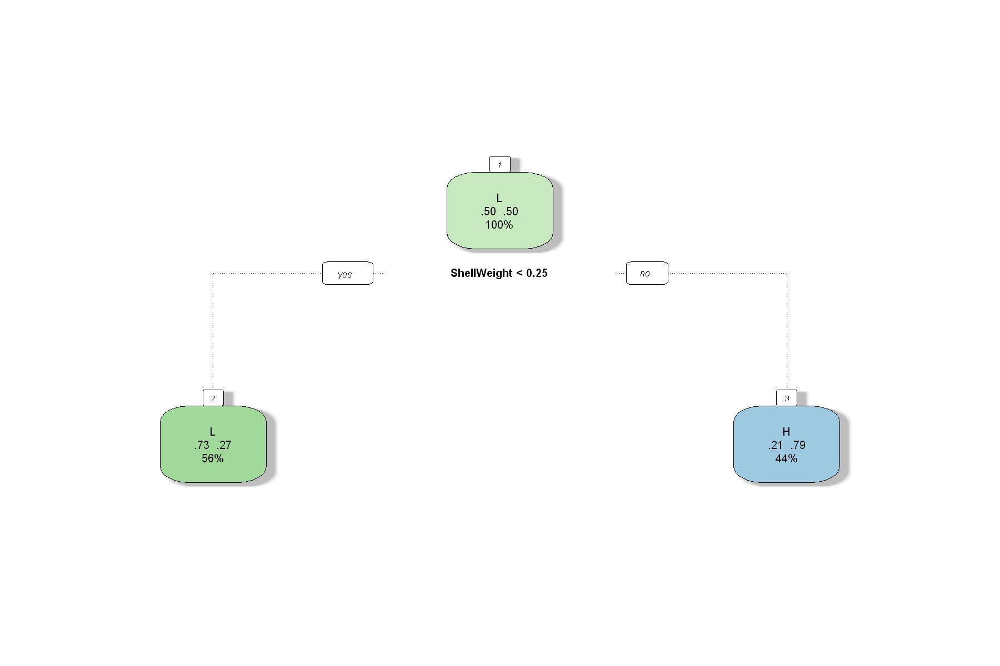

In [73]:
set.seed(2)    #固定xstd：xerror具有随机性--数据随机分割的原因
ctab <- rpart(Rings ~ .,data = train_ab, control = list(maxsurrogate = 7 ), method = "class", cp = 0.2)  
summary(ctab)
fancyRpartPlot(ctab, caption = "")

In [74]:
ctab$control

$minsplit
[1] 20

$minbucket
[1] 7

$cp
[1] 0.2

$maxcompete
[1] 4

$maxsurrogate
[1] 7

$usesurrogate
[1] 2

$surrogatestyle
[1] 0

$maxdepth
[1] 30

$xval
[1] 10

maxsurrogate--
the number of surrogate splits retained in the output. If this is set to zero the
compute time will be reduced, since approximately half of the computational
time (other than setup) is used in the search for surrogate splits.在输出中保留的代理分割的数量。如果将其设置为零，计算时间将减少，因为大约一半的计算时间(除了设置)用于搜索代理分割。

usesurrogate--
how to use surrogates in the splitting process. 0 means display only; an observation with a missing value for the primary split原则 is not sent further down
the tree. 1 means use surrogates, in order, to split subjects missing the primary variable; if all surrogates are missing the observation is not split. For value 2 (default),if
all surrogates are missing, then send the observation in the majority direction. 如何在拆分过程中使用代理。0表示只显示;缺少主分割规则值的观测值不会发送到树的下一级。1表示使用替代物，以便分割缺少主要变量的受试者;如果所有的代理缺失，则观察结果不分裂。对于值2(默认值)，如果缺少所有的代理，则向多数方向发送观察结果。

**观察“Surrogate splits”的用法**

首先，“ShellWeight”值缺失：

In [75]:
test_ab[1,"ShellWeight"] <- NA
test_ab[1,]

,Type,LongestShell,Diameter,Height,WholeWeight,ShuckedWeight,VisceraWeight,ShellWeight,Rings
,<fct>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<fct>
3,F,0.53,0.42,0.135,0.677,0.2565,0.1415,NA,L


In [76]:
predict(ctab, test_ab[1,], type = "class") 

3 
L 
Levels: L H

In [77]:
test_ab[16,"ShellWeight"] <- NA
test_ab[16,]

,Type,LongestShell,Diameter,Height,WholeWeight,ShuckedWeight,VisceraWeight,ShellWeight,Rings
,<fct>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<fct>
27,F,0.58,0.45,0.185,0.9955,0.3945,0.272,NA,H


In [78]:
predict(ctab, test_ab[16,], type = "class") 

27 
 H 
Levels: L H

ShellWeight和WholeWeight均缺失

In [79]:
test_ab[1,"WholeWeight"] <- NA
test_ab[1,]

,Type,LongestShell,Diameter,Height,WholeWeight,ShuckedWeight,VisceraWeight,ShellWeight,Rings
,<fct>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<fct>
3,F,0.53,0.42,0.135,NA,0.2565,0.1415,NA,L


In [80]:
predict(ctab, test_ab[1,], type = "class") 

3 
L 
Levels: L H

In [81]:
test_ab[16,"WholeWeight"] <- NA
test_ab[16,]

,Type,LongestShell,Diameter,Height,WholeWeight,ShuckedWeight,VisceraWeight,ShellWeight,Rings
,<fct>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<fct>
27,F,0.58,0.45,0.185,NA,0.3945,0.272,NA,H


In [82]:
predict(ctab, test_ab[16,], type = "class") 

27 
 H 
Levels: L H

ShellWeight和WholeWeight、Diameter均缺失

In [83]:
test_ab[1,"Diameter"] <- NA
test_ab[1,]

,Type,LongestShell,Diameter,Height,WholeWeight,ShuckedWeight,VisceraWeight,ShellWeight,Rings
,<fct>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<fct>
3,F,0.53,NA,0.135,NA,0.2565,0.1415,NA,L


In [84]:
predict(ctab, test_ab[1,], type = "class") 

3 
L 
Levels: L H

In [85]:
test_ab[16,"Diameter"] <- NA
test_ab[16,]

,Type,LongestShell,Diameter,Height,WholeWeight,ShuckedWeight,VisceraWeight,ShellWeight,Rings
,<fct>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<fct>
27,F,0.58,NA,0.185,NA,0.3945,0.272,NA,H


In [86]:
predict(ctab, test_ab[16,], type = "class") 

27 
 H 
Levels: L H

**按序使用“Surrogate”时的误差**

      ShellWeight-> WholeWeight-> Diameter-> LongestShell-> VisceraWeight-> ShuckedWeight-> Height->Type 依次缺失

In [87]:
#无缺失
test_ab <- ab[-I, ]
s(test_ab)

pred_te <- predict(ctab, test_ab, type = "class")       #测试集的预测值
(error_test <- mean(pred_te != test_ab$Rings))    #测试集的错误率

── Data Summary ────────────────────────
                           Values
Name                       data  
Number of rows             2089  
Number of columns          9     
_______________________          
Column type frequency:           
  factor                   2     
  numeric                  7     
________________________         
Group variables            None  

── Variable type: factor ───────────────────────────────────────────────────────────────────────────────────────────────────────────────────
  skim_variable n_missing complete_rate ordered n_unique top_counts            
1 Type                  0             1 FALSE          3 M: 752, F: 670, I: 667
2 Rings                 0             1 FALSE          2 L: 1052, H: 1037      

── Variable type: numeric ──────────────────────────────────────────────────────────────────────────────────────────────────────────────────
  skim_variable n_missing complete_rate  mean     sd     p0   p25   p50   p75  p100 hist 
1 Lon

[1] 0.2426999

In [88]:
test_ab[,"ShellWeight"] <- NA  
test_ab[,"ShellWeight"] <- as.numeric(test_ab[,"ShellWeight"])
s(test_ab)

pred_te <- predict(ctab, test_ab, type = "class")       #测试集的预测值
(error_test <- mean(pred_te != test_ab$Rings))    #测试集的错误率

── Data Summary ────────────────────────
                           Values
Name                       data  
Number of rows             2089  
Number of columns          9     
_______________________          
Column type frequency:           
  factor                   2     
  numeric                  7     
________________________         
Group variables            None  

── Variable type: factor ───────────────────────────────────────────────────────────────────────────────────────────────────────────────────
  skim_variable n_missing complete_rate ordered n_unique top_counts            
1 Type                  0             1 FALSE          3 M: 752, F: 670, I: 667
2 Rings                 0             1 FALSE          2 L: 1052, H: 1037      

── Variable type: numeric ──────────────────────────────────────────────────────────────────────────────────────────────────────────────────
  skim_variable n_missing complete_rate    mean      sd      p0    p25    p50    p75   p100 his

[1] 0.2786022

In [89]:
test_ab[,"WholeWeight"] <- NA  
test_ab[,"WholeWeight"] <- as.numeric(test_ab[,"WholeWeight"])
s(test_ab)

pred_te <- predict(ctab, test_ab, type = "class")       #测试集的预测值
(error_test <- mean(pred_te != test_ab$Rings))    #测试集的错误率

── Data Summary ────────────────────────
                           Values
Name                       data  
Number of rows             2089  
Number of columns          9     
_______________________          
Column type frequency:           
  factor                   2     
  numeric                  7     
________________________         
Group variables            None  

── Variable type: factor ───────────────────────────────────────────────────────────────────────────────────────────────────────────────────
  skim_variable n_missing complete_rate ordered n_unique top_counts            
1 Type                  0             1 FALSE          3 M: 752, F: 670, I: 667
2 Rings                 0             1 FALSE          2 L: 1052, H: 1037      

── Variable type: numeric ──────────────────────────────────────────────────────────────────────────────────────────────────────────────────
  skim_variable n_missing complete_rate    mean      sd      p0    p25    p50    p75   p100 his

[1] 0.2896123

In [90]:
test_ab[,"Diameter"] <- NA  
test_ab[,"Diameter"] <- as.numeric(test_ab[,"Diameter"])
s(test_ab)

pred_te <- predict(ctab, test_ab, type = "class")       #测试集的预测值
(error_test <- mean(pred_te != test_ab$Rings))    #测试集的错误率

── Data Summary ────────────────────────
                           Values
Name                       data  
Number of rows             2089  
Number of columns          9     
_______________________          
Column type frequency:           
  factor                   2     
  numeric                  7     
________________________         
Group variables            None  

── Variable type: factor ───────────────────────────────────────────────────────────────────────────────────────────────────────────────────
  skim_variable n_missing complete_rate ordered n_unique top_counts            
1 Type                  0             1 FALSE          3 M: 752, F: 670, I: 667
2 Rings                 0             1 FALSE          2 L: 1052, H: 1037      

── Variable type: numeric ──────────────────────────────────────────────────────────────────────────────────────────────────────────────────
  skim_variable n_missing complete_rate    mean      sd      p0    p25    p50    p75   p100 his

[1] 0.2920057

In [91]:
test_ab[,"LongestShell"] <- NA  
test_ab[,"LongestShell"] <- as.numeric(test_ab[,"LongestShell"])
s(test_ab)

pred_te <- predict(ctab, test_ab, type = "class")       #测试集的预测值
(error_test <- mean(pred_te != test_ab$Rings))    #测试集的错误率

── Data Summary ────────────────────────
                           Values
Name                       data  
Number of rows             2089  
Number of columns          9     
_______________________          
Column type frequency:           
  factor                   2     
  numeric                  7     
________________________         
Group variables            None  

── Variable type: factor ───────────────────────────────────────────────────────────────────────────────────────────────────────────────────
  skim_variable n_missing complete_rate ordered n_unique top_counts            
1 Type                  0             1 FALSE          3 M: 752, F: 670, I: 667
2 Rings                 0             1 FALSE          2 L: 1052, H: 1037      

── Variable type: numeric ──────────────────────────────────────────────────────────────────────────────────────────────────────────────────
  skim_variable n_missing complete_rate    mean      sd      p0    p25    p50    p75   p100 his

[1] 0.2881762

In [92]:
test_ab[,"VisceraWeight"] <- NA  
test_ab[,"VisceraWeight"] <- as.numeric(test_ab[,"VisceraWeight"])
s(test_ab)

pred_te <- predict(ctab, test_ab, type = "class")       #测试集的预测值
(error_test <- mean(pred_te != test_ab$Rings))    #测试集的错误率

── Data Summary ────────────────────────
                           Values
Name                       data  
Number of rows             2089  
Number of columns          9     
_______________________          
Column type frequency:           
  factor                   2     
  numeric                  7     
________________________         
Group variables            None  

── Variable type: factor ───────────────────────────────────────────────────────────────────────────────────────────────────────────────────
  skim_variable n_missing complete_rate ordered n_unique top_counts            
1 Type                  0             1 FALSE          3 M: 752, F: 670, I: 667
2 Rings                 0             1 FALSE          2 L: 1052, H: 1037      

── Variable type: numeric ──────────────────────────────────────────────────────────────────────────────────────────────────────────────────
  skim_variable n_missing complete_rate    mean      sd     p0    p25   p50    p75  p100 hist  

[1] 0.3212063

In [93]:
test_ab[,"ShuckedWeight"] <- NA  
test_ab[,"ShuckedWeight"] <- as.numeric(test_ab[,"ShuckedWeight"])
s(test_ab)

pred_te <- predict(ctab, test_ab, type = "class")       #测试集的预测值
(error_test <- mean(pred_te != test_ab$Rings))    #测试集的错误率

── Data Summary ────────────────────────
                           Values
Name                       data  
Number of rows             2089  
Number of columns          9     
_______________________          
Column type frequency:           
  factor                   2     
  numeric                  7     
________________________         
Group variables            None  

── Variable type: factor ───────────────────────────────────────────────────────────────────────────────────────────────────────────────────
  skim_variable n_missing complete_rate ordered n_unique top_counts            
1 Type                  0             1 FALSE          3 M: 752, F: 670, I: 667
2 Rings                 0             1 FALSE          2 L: 1052, H: 1037      

── Variable type: numeric ──────────────────────────────────────────────────────────────────────────────────────────────────────────────────
  skim_variable n_missing complete_rate    mean      sd p0    p25   p50    p75  p100 hist   
1 

[1] 0.2618478

In [94]:
test_ab[,"Height"] <- NA  
test_ab[,"Height"] <- as.numeric(test_ab[,"Height"])
s(test_ab)

pred_te <- predict(ctab, test_ab, type = "class")       #测试集的预测值
(error_test <- mean(pred_te != test_ab$Rings))    #测试集的错误率

── Data Summary ────────────────────────
                           Values
Name                       data  
Number of rows             2089  
Number of columns          9     
_______________________          
Column type frequency:           
  factor                   2     
  numeric                  7     
________________________         
Group variables            None  

── Variable type: factor ───────────────────────────────────────────────────────────────────────────────────────────────────────────────────
  skim_variable n_missing complete_rate ordered n_unique top_counts            
1 Type                  0             1 FALSE          3 M: 752, F: 670, I: 667
2 Rings                 0             1 FALSE          2 L: 1052, H: 1037      

── Variable type: numeric ──────────────────────────────────────────────────────────────────────────────────────────────────────────────────
  skim_variable n_missing complete_rate mean sd p0 p25 p50 p75 p100 hist
1 LongestShell       2

[1] 0.2991862

In [95]:
test_ab[,"Type"] <- NA  
test_ab[,"Type"] <- as.character(test_ab[,"Type"])
s(test_ab)

pred_te <- predict(ctab, test_ab, type = "class")       #测试集的预测值
(error_test <- mean(pred_te != test_ab$Rings))    #测试集的错误率

── Data Summary ────────────────────────
                           Values
Name                       data  
Number of rows             2089  
Number of columns          9     
_______________________          
Column type frequency:           
  character                1     
  factor                   1     
  numeric                  7     
________________________         
Group variables            None  

── Variable type: character ────────────────────────────────────────────────────────────────────────────────────────────────────────────────
  skim_variable n_missing complete_rate min max empty n_unique whitespace
1 Type               2089             0 NA  NA      0        0          0

── Variable type: factor ───────────────────────────────────────────────────────────────────────────────────────────────────────────────────
  skim_variable n_missing complete_rate ordered n_unique top_counts      
1 Rings                 0             1 FALSE          2 L: 1052, H: 1037

── V

[1] 0.4964098

In [96]:
#所有surrogate缺失，取大类
1037/(1052+1037)

[1] 0.4964098

###  时间复杂度

#### classification-特征全为类别值

In [97]:
options(warn=-1)    #忽略一切警告
options('width'=140)  #充分利用打印宽度
options(repr.plot.width=15, repr.plot.height=10)  #满幅
p_load(rpart)
p_load(skimr)
s <- skim_tee

In [98]:
mr <- treemisc::mushroom 
s(mr)

── Data Summary ────────────────────────
                           Values
Name                       data  
Number of rows             8124  
Number of columns          23    
_______________________          
Column type frequency:           
  factor                   23    
________________________         
Group variables            None  

── Variable type: factor ───────────────────────────────────────────────────────────────────────────────────────────────────────────────────
   skim_variable            n_missing complete_rate ordered n_unique top_counts                                
 1 Edibility                        0             1 FALSE          2 Edi: 4208, Poi: 3916                      
 2 cap.shape                        0             1 FALSE          6 con: 3656, fla: 3152, kno: 828, bel: 452  
 3 cap.surface                      0             1 FALSE          4 sca: 3244, smo: 2556, fib: 2320, gro: 4   
 4 cap.color                        0             1 FALSE      

  |==================================================================================================================================| 100%

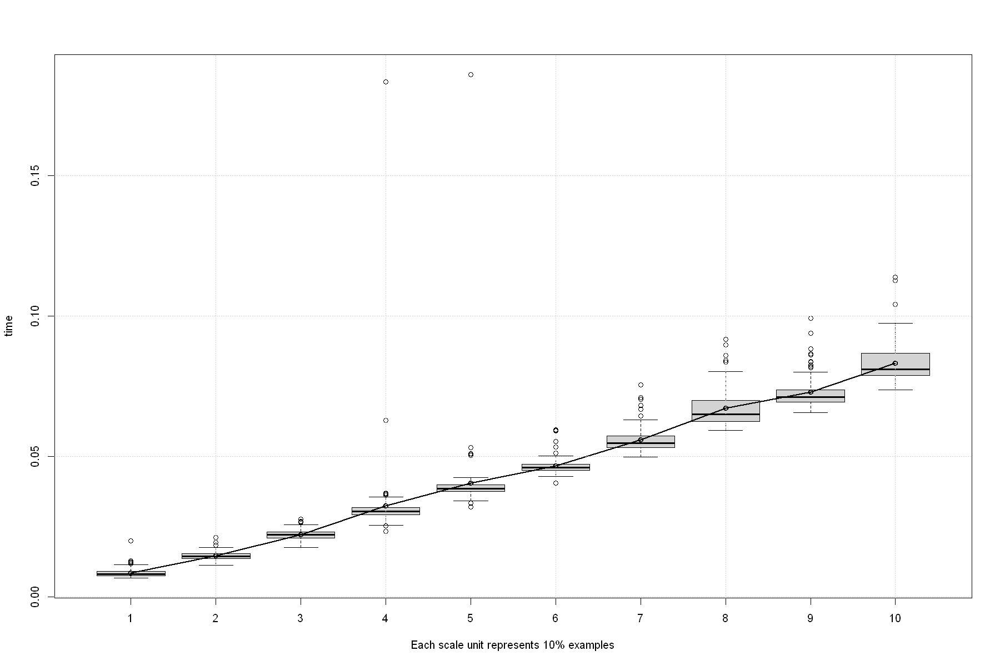

In [99]:
mr <- treemisc::mushroom

N <- 10 # 数据规格数
M <- 100 # 每种数据量实验次数
rc <- matrix(-1, M, N) # 用于存储实验结果
colnames(rc) <- as.character(1:N) # 每列对应于不同的数据规格
nr <- nrow(mr)

pb <- txtProgressBar(style = 3)
for (n in 1:N) {
  for (m in 1:M) {
    set.seed(n*1000+m)
    I <- sample(nr, (n * nr / N))
    d <- mr[I, ]
    timestart <- Sys.time()
    rpart(Edibility ~ ., data = d, cp = 0)
    rc[m, n] <- difftime(Sys.time(), timestart, units = "secs")
  }
  setTxtProgressBar(pb, n / N)
}

boxplot(rc, xlab = "Each scale unit represents 10% examples", ylab = "time")
lines(colMeans(rc), type = "o", lwd = 2)
grid()

#可见呈直线

#### classification-特征全为连续值

In [100]:
options(warn=-1)    #忽略一切警告
options('width'=140)  #充分利用打印宽度
options(repr.plot.width=15, repr.plot.height=10)  #满幅
p_load(rpart)
p_load(skimr)
s <- skim_tee

In [101]:
set.seed(943) # for reproducibility
fr <- treemisc::gen_friedman1(1000, nx = 20, sigma = 0.1)
fr$y <- factor(ifelse(fr$y < 14.2 , 0 , 1))
s(fr)

── Data Summary ────────────────────────
                           Values
Name                       data  
Number of rows             1000  
Number of columns          21    
_______________________          
Column type frequency:           
  factor                   1     
  numeric                  20    
________________________         
Group variables            None  

── Variable type: factor ───────────────────────────────────────────────────────────────────────────────────────────────────────────────────
  skim_variable n_missing complete_rate ordered n_unique top_counts    
1 y                     0             1 FALSE          2 0: 506, 1: 494

── Variable type: numeric ──────────────────────────────────────────────────────────────────────────────────────────────────────────────────
   skim_variable n_missing complete_rate  mean    sd        p0   p25   p50   p75  p100 hist 
 1 x1                    0             1 0.505 0.294 0.00129   0.238 0.511 0.769 1.00  ▇▇▇▇▇
 2 x2

  |==================================================================================================================================| 100%

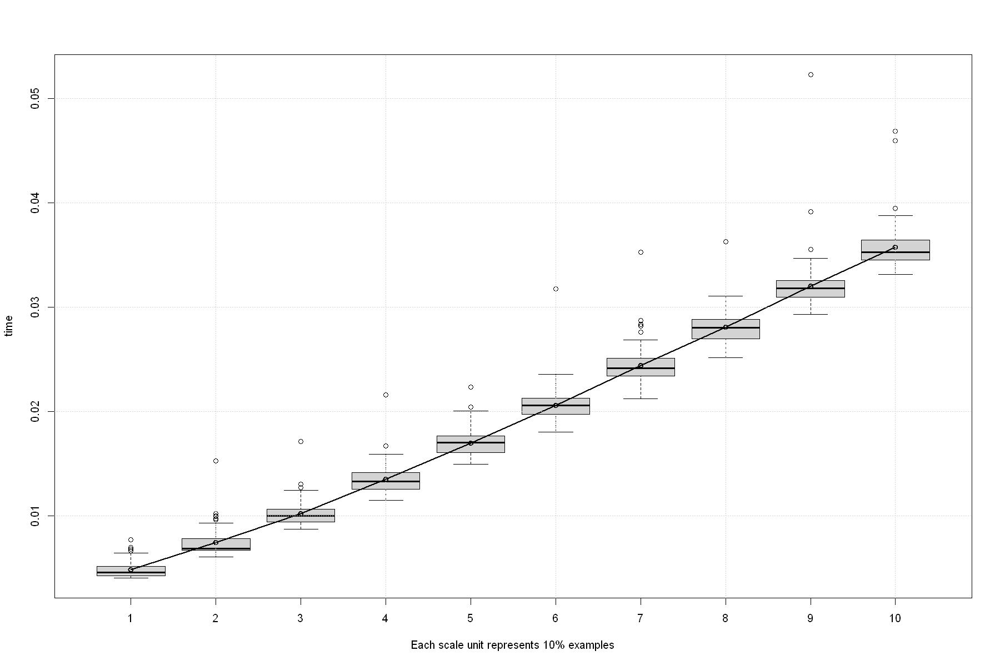

In [102]:
N <- 10 # 数据规格数
M <- 100 # 每种数据量实验次数
rc <- matrix(-1, M, N) # 用于存储实验结果
colnames(rc) <- as.character(1:N) # 每列对应于不同的数据规格
nr <- nrow(fr)

pb <- txtProgressBar(style = 3)
for (n in 1:N) {
  for (m in 1:M) {
    set.seed(n*1000+m)
    I <- sample(nr, (n * nr / N))
    d <- fr[I, ]
    timestart <- Sys.time()
    rpart(y ~ ., data = d, cp = 0)
    rc[m, n] <- difftime(Sys.time(), timestart, units = "secs")
  }
  setTxtProgressBar(pb, n / N)
}

boxplot(rc, xlab = "Each scale unit represents 10% examples", ylab = "time")
lines(colMeans(rc), type = "o", lwd = 2)
grid()

#可见呈直线

#### regression-特征全为连续值

In [103]:
options(warn=-1)    #忽略一切警告
options('width'=140)  #充分利用打印宽度
options(repr.plot.width=15, repr.plot.height=10)  #满幅
p_load(rpart)
p_load(skimr)
s <- skim_tee

In [104]:
set.seed(943) # for reproducibility
fr <- treemisc::gen_friedman1(1000, nx = 20, sigma = 0.1)
s(fr)

── Data Summary ────────────────────────
                           Values
Name                       data  
Number of rows             1000  
Number of columns          21    
_______________________          
Column type frequency:           
  numeric                  21    
________________________         
Group variables            None  

── Variable type: numeric ──────────────────────────────────────────────────────────────────────────────────────────────────────────────────
   skim_variable n_missing complete_rate   mean    sd        p0    p25    p50    p75   p100 hist 
 1 y                     0             1 14.1   4.88  1.72      10.8   14.2   17.5   27.3   ▂▅▇▅▁
 2 x1                    0             1  0.505 0.294 0.00129    0.238  0.511  0.769  1.00  ▇▇▇▇▇
 3 x2                    0             1  0.492 0.292 0.00134    0.231  0.499  0.749  0.999 ▇▇▇▇▇
 4 x3                    0             1  0.490 0.285 0.000113   0.242  0.482  0.740  0.999 ▇▇▇▇▇
 5 x4                

  |==================================================================================================================================| 100%

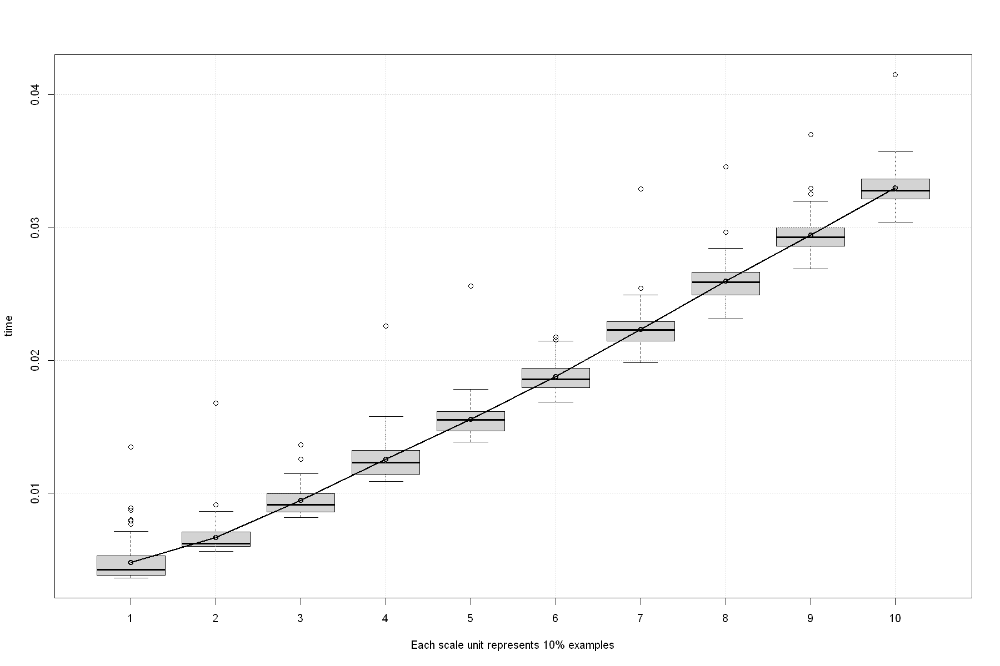

In [105]:
N <- 10 # 数据规格数
M <- 100 # 每种数据量实验次数
rc <- matrix(-1, M, N) # 用于存储实验结果
colnames(rc) <- as.character(1:N) # 每列对应于不同的数据规格
nr <- nrow(fr)

pb <- txtProgressBar(style = 3)
for (n in 1:N) {
  for (m in 1:M) {
    set.seed(n*1000+m)
    I <- sample(nr, (n * nr / N))
    d <- fr[I, ]
    timestart <- Sys.time()
    rpart(y ~ ., data = d, cp = 0)
    rc[m, n] <- difftime(Sys.time(), timestart, units = "secs")
  }
  setTxtProgressBar(pb, n / N)
}

boxplot(rc, xlab = "Each scale unit represents 10% examples", ylab = "time")
lines(colMeans(rc), type = "o", lwd = 2)
grid()

#可见呈直线